# Football: Qui va gagner ? 🏆

---

## Group Members:

- **Mohamed Amine Tlili**  
- **Mohamed Aziz Loukil**  
- **Mohamed Laatar**

---

## Importing Libraries 📚

To begin our analysis and prediction, we need to import the necessary libraries. These libraries will help us manipulate data, visualize trends, and train machine learning models.


In [186]:
import warnings
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import GridSearchCV, train_test_split, cross_val_score
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import make_scorer,accuracy_score,f1_score, classification_report, confusion_matrix, precision_score
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.utils import compute_class_weight
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.impute import SimpleImputer
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.linear_model import LassoCV, LogisticRegression
from sklearn.base import BaseEstimator, ClassifierMixin
from sklearn.pipeline import make_pipeline
from sklearn.cluster import AgglomerativeClustering, KMeans
from sklearn.decomposition import PCA
from sklearn.naive_bayes import GaussianNB
from sklearn import model_selection
from collections import Counter
import xgboost as xgb
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras import optimizers
warnings.filterwarnings('ignore')

In [90]:
import os
print(os.getcwd())

c:\Users\Mohamed Aziz\Documents\gustave course\Machine Learning\ML Project\ML Project


## Loading and Preparing Data 🏟️

In this step, we load multiple datasets related to football match statistics and preprocess them for analysis. We handle both the training and testing data to ensure consistency and readiness for model training.

- Load Team Data (Train and Test)

In [91]:
train_home_team_statistics_df = pd.read_csv('Train_Data/train_home_team_statistics_df.csv' )
train_away_team_statistics_df = pd.read_csv('Train_Data/train_away_team_statistics_df.csv' )

train_scores = pd.read_csv('Y_train.csv', index_col=0)

train_home = pd.concat([train_home_team_statistics_df.iloc[:, :1], train_home_team_statistics_df.iloc[:, 3:]], axis=1)
train_away = pd.concat([train_away_team_statistics_df.iloc[:, :1], train_away_team_statistics_df.iloc[:, 3:]], axis=1)


train_home.columns = 'HOME_' + train_home.columns
train_away.columns = 'AWAY_' + train_away.columns

train_data =  pd.concat([train_home,train_away],join='inner',axis=1)
train_scores = train_scores.loc[train_data.index]

train_data = train_data.replace({np.inf:np.nan,-np.inf:np.nan})

In [92]:
test_home_team_statistics_df = pd.read_csv('Test_Data/test_home_team_statistics_df.csv' )
test_away_team_statistics_df = pd.read_csv('Test_Data/test_away_team_statistics_df.csv' )

test_home = pd.concat([test_home_team_statistics_df.iloc[:, :1], test_home_team_statistics_df.iloc[:, 3:]], axis=1)
test_away = pd.concat([test_away_team_statistics_df.iloc[:, :1], test_away_team_statistics_df.iloc[:, 3:]], axis=1)

test_home.columns = 'HOME_' + test_home.columns
test_away.columns = 'AWAY_' + test_away.columns

test_data =  pd.concat([test_home,test_away],join='inner',axis=1)

test_data = test_data.replace({np.inf:np.nan,-np.inf:np.nan})

In [93]:
train_data = pd.concat([train_data, train_scores], axis=1)

In [94]:
train_data.head()

,HOME_ID,HOME_TEAM_SHOTS_TOTAL_season_sum,HOME_TEAM_SHOTS_INSIDEBOX_season_sum,HOME_TEAM_SHOTS_OFF_TARGET_season_sum,HOME_TEAM_SHOTS_ON_TARGET_season_sum,HOME_TEAM_SHOTS_OUTSIDEBOX_season_sum,HOME_TEAM_PASSES_season_sum,HOME_TEAM_SUCCESSFUL_PASSES_season_sum,HOME_TEAM_SAVES_season_sum,HOME_TEAM_CORNERS_season_sum,...,AWAY_TEAM_ATTACKS_5_last_match_std,AWAY_TEAM_PENALTIES_5_last_match_std,AWAY_TEAM_SUBSTITUTIONS_5_last_match_std,AWAY_TEAM_BALL_SAFE_5_last_match_std,AWAY_TEAM_DANGEROUS_ATTACKS_5_last_match_std,AWAY_TEAM_INJURIES_5_last_match_std,AWAY_TEAM_GOALS_5_last_match_std,HOME_WINS,DRAW,AWAY_WINS
0,0,3.0,2.0,5.0,2.0,1.0,2.0,2.0,5.0,3.0,...,0.0,6.0,8.0,4.0,3.0,2.0,3.0,0,0,1
1,1,6.0,8.0,3.0,6.0,5.0,8.0,7.0,10.0,6.0,...,1.0,8.0,4.0,10.0,0.0,5.0,3.0,0,1,0
2,2,4.0,2.0,5.0,2.0,8.0,1.0,1.0,2.0,2.0,...,4.0,0.0,8.0,3.0,0.0,9.0,6.0,0,0,1
3,3,7.0,5.0,5.0,6.0,6.0,9.0,9.0,2.0,2.0,...,2.0,0.0,5.0,6.0,3.0,NaN,2.0,1,0,0
4,4,3.0,3.0,2.0,3.0,4.0,4.0,3.0,4.0,4.0,...,4.0,9.0,4.0,1.0,4.0,6.0,5.0,0,1,0


In [95]:
train_data.shape

(12303, 285)

In [96]:
test_data.shape

(25368, 278)

- Load Player Data (Train and Test)

In [97]:
train_home_Player_statistics_df = pd.read_csv('Train_Data/train_home_Player_statistics_df.csv')
train_away_Player_statistics_df = pd.read_csv('Train_Data/train_away_Player_statistics_df.csv')


train_homePlayer = train_home_Player_statistics_df
train_awayPlayer = train_away_Player_statistics_df

train_homePlayer.columns = 'HOME_' + train_homePlayer.columns
train_awayPlayer.columns = 'AWAY_' + train_awayPlayer.columns

In [98]:
test_home_Player_statistics_df = pd.read_csv('Test_Data/test_home_Player_statistics_df.csv')
test_away_Player_statistics_df = pd.read_csv('Test_Data/test_away_Player_statistics_df.csv')


test_homePlayer = test_home_Player_statistics_df
test_awayPlayer = test_away_Player_statistics_df

test_homePlayer.columns = 'HOME_' + test_homePlayer.columns
test_awayPlayer.columns = 'AWAY_' + test_awayPlayer.columns

## Data Understanding and Preprocessing 🔍

### 1. Feature Selection

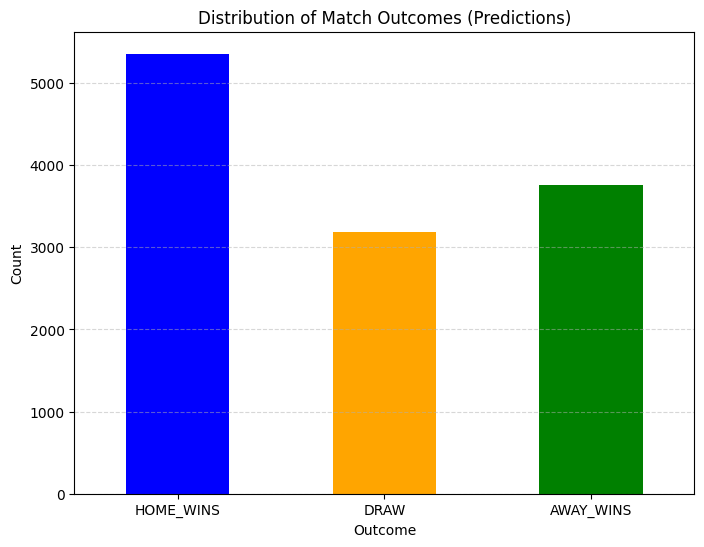

In [99]:
outcome_counts = train_scores[['HOME_WINS', 'DRAW', 'AWAY_WINS']].sum()
# Plot the distribution as a bar chart
plt.figure(figsize=(8, 6))
outcome_counts.plot(kind='bar', color=['blue', 'orange', 'green'])
plt.title('Distribution of Match Outcomes (Predictions)')
plt.xlabel('Outcome')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.show()

In [100]:
train_scores.head()

,HOME_WINS,DRAW,AWAY_WINS
0,0,0,1
1,0,1,0
2,0,0,1
3,1,0,0
4,0,1,0


In [101]:
train_data.head()

,HOME_ID,HOME_TEAM_SHOTS_TOTAL_season_sum,HOME_TEAM_SHOTS_INSIDEBOX_season_sum,HOME_TEAM_SHOTS_OFF_TARGET_season_sum,HOME_TEAM_SHOTS_ON_TARGET_season_sum,HOME_TEAM_SHOTS_OUTSIDEBOX_season_sum,HOME_TEAM_PASSES_season_sum,HOME_TEAM_SUCCESSFUL_PASSES_season_sum,HOME_TEAM_SAVES_season_sum,HOME_TEAM_CORNERS_season_sum,...,AWAY_TEAM_ATTACKS_5_last_match_std,AWAY_TEAM_PENALTIES_5_last_match_std,AWAY_TEAM_SUBSTITUTIONS_5_last_match_std,AWAY_TEAM_BALL_SAFE_5_last_match_std,AWAY_TEAM_DANGEROUS_ATTACKS_5_last_match_std,AWAY_TEAM_INJURIES_5_last_match_std,AWAY_TEAM_GOALS_5_last_match_std,HOME_WINS,DRAW,AWAY_WINS
0,0,3.0,2.0,5.0,2.0,1.0,2.0,2.0,5.0,3.0,...,0.0,6.0,8.0,4.0,3.0,2.0,3.0,0,0,1
1,1,6.0,8.0,3.0,6.0,5.0,8.0,7.0,10.0,6.0,...,1.0,8.0,4.0,10.0,0.0,5.0,3.0,0,1,0
2,2,4.0,2.0,5.0,2.0,8.0,1.0,1.0,2.0,2.0,...,4.0,0.0,8.0,3.0,0.0,9.0,6.0,0,0,1
3,3,7.0,5.0,5.0,6.0,6.0,9.0,9.0,2.0,2.0,...,2.0,0.0,5.0,6.0,3.0,NaN,2.0,1,0,0
4,4,3.0,3.0,2.0,3.0,4.0,4.0,3.0,4.0,4.0,...,4.0,9.0,4.0,1.0,4.0,6.0,5.0,0,1,0


In [102]:
pd.options.display.max_rows = None  # Show all rows
print(train_data.dtypes)

HOME_ID                                                          int64
HOME_TEAM_SHOTS_TOTAL_season_sum                               float64
HOME_TEAM_SHOTS_INSIDEBOX_season_sum                           float64
HOME_TEAM_SHOTS_OFF_TARGET_season_sum                          float64
HOME_TEAM_SHOTS_ON_TARGET_season_sum                           float64
HOME_TEAM_SHOTS_OUTSIDEBOX_season_sum                          float64
HOME_TEAM_PASSES_season_sum                                    float64
HOME_TEAM_SUCCESSFUL_PASSES_season_sum                         float64
HOME_TEAM_SAVES_season_sum                                     float64
HOME_TEAM_CORNERS_season_sum                                   float64
HOME_TEAM_FOULS_season_sum                                     float64
HOME_TEAM_YELLOWCARDS_season_sum                               float64
HOME_TEAM_REDCARDS_season_sum                                  float64
HOME_TEAM_OFFSIDES_season_sum                                  float64
HOME_T

In [103]:
train_data.columns.tolist()

['HOME_ID',
 'HOME_TEAM_SHOTS_TOTAL_season_sum',
 'HOME_TEAM_SHOTS_INSIDEBOX_season_sum',
 'HOME_TEAM_SHOTS_OFF_TARGET_season_sum',
 'HOME_TEAM_SHOTS_ON_TARGET_season_sum',
 'HOME_TEAM_SHOTS_OUTSIDEBOX_season_sum',
 'HOME_TEAM_PASSES_season_sum',
 'HOME_TEAM_SUCCESSFUL_PASSES_season_sum',
 'HOME_TEAM_SAVES_season_sum',
 'HOME_TEAM_CORNERS_season_sum',
 'HOME_TEAM_FOULS_season_sum',
 'HOME_TEAM_YELLOWCARDS_season_sum',
 'HOME_TEAM_REDCARDS_season_sum',
 'HOME_TEAM_OFFSIDES_season_sum',
 'HOME_TEAM_ATTACKS_season_sum',
 'HOME_TEAM_PENALTIES_season_sum',
 'HOME_TEAM_SUBSTITUTIONS_season_sum',
 'HOME_TEAM_BALL_SAFE_season_sum',
 'HOME_TEAM_DANGEROUS_ATTACKS_season_sum',
 'HOME_TEAM_INJURIES_season_sum',
 'HOME_TEAM_GOALS_season_sum',
 'HOME_TEAM_GAME_WON_season_sum',
 'HOME_TEAM_GAME_DRAW_season_sum',
 'HOME_TEAM_GAME_LOST_season_sum',
 'HOME_TEAM_SHOTS_TOTAL_season_average',
 'HOME_TEAM_SHOTS_INSIDEBOX_season_average',
 'HOME_TEAM_SHOTS_OFF_TARGET_season_average',
 'HOME_TEAM_SHOTS_ON_TAR

In [104]:
def show_numerical_statistics(dataframe):
    # Get basic descriptive statistics for numerical columns
    numerical_summary = dataframe.describe(include=[np.number]).T
    
    # Add additional statistics if needed
    numerical_summary['missing_values'] = dataframe.isnull().sum()
    numerical_summary['unique_values'] = dataframe.nunique()
    numerical_summary['median'] = dataframe.median()
    
    return numerical_summary


stats = show_numerical_statistics(train_data)
print(stats)

                                                      count         mean  \
HOME_ID                                             12303.0  6151.000000   
HOME_TEAM_SHOTS_TOTAL_season_sum                    12043.0     4.391182   
HOME_TEAM_SHOTS_INSIDEBOX_season_sum                10918.0     4.299872   
HOME_TEAM_SHOTS_OFF_TARGET_season_sum               12303.0     4.511339   
HOME_TEAM_SHOTS_ON_TARGET_season_sum                12301.0     4.150882   
HOME_TEAM_SHOTS_OUTSIDEBOX_season_sum               10916.0     4.524643   
HOME_TEAM_PASSES_season_sum                         10890.0     4.350597   
HOME_TEAM_SUCCESSFUL_PASSES_season_sum              10919.0     4.130049   
HOME_TEAM_SAVES_season_sum                          11523.0     4.674043   
HOME_TEAM_CORNERS_season_sum                        12302.0     4.505284   
HOME_TEAM_FOULS_season_sum                          11546.0     5.135718   
HOME_TEAM_YELLOWCARDS_season_sum                    12298.0     4.795820   
HOME_TEAM_RE

In [105]:
def count_columns_with_keywords(dataframe, keywords):
    counts = {keyword: 0 for keyword in keywords}
    for col in dataframe.columns:
        for keyword in keywords:
            if keyword in col.lower():
                counts[keyword] += 1
    return counts

keywords = ['std', 'average', 'sum']
keyword_counts = count_columns_with_keywords(train_data, keywords)
print(f"Counts for columns with keywords: {keyword_counts}")

Counts for columns with keywords: {'std': 88, 'average': 100, 'sum': 92}


In [106]:
def get_columns_with_std(dataframe):
    # Filter column names that contain 'std' (case-insensitive)
    columns_with_std = [col for col in dataframe.columns if '_std' in col.lower()]
    return columns_with_std

# Example usage
# Assuming `df` is your DataFrame
columns_with_std = get_columns_with_std(train_data)
print(f"Columns containing 'std': {columns_with_std}")

Columns containing 'std': ['HOME_TEAM_SHOTS_TOTAL_season_std', 'HOME_TEAM_SHOTS_INSIDEBOX_season_std', 'HOME_TEAM_SHOTS_OFF_TARGET_season_std', 'HOME_TEAM_SHOTS_ON_TARGET_season_std', 'HOME_TEAM_SHOTS_OUTSIDEBOX_season_std', 'HOME_TEAM_PASSES_season_std', 'HOME_TEAM_SUCCESSFUL_PASSES_season_std', 'HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_std', 'HOME_TEAM_SAVES_season_std', 'HOME_TEAM_CORNERS_season_std', 'HOME_TEAM_BALL_POSSESSION_season_std', 'HOME_TEAM_FOULS_season_std', 'HOME_TEAM_YELLOWCARDS_season_std', 'HOME_TEAM_REDCARDS_season_std', 'HOME_TEAM_OFFSIDES_season_std', 'HOME_TEAM_ATTACKS_season_std', 'HOME_TEAM_PENALTIES_season_std', 'HOME_TEAM_SUBSTITUTIONS_season_std', 'HOME_TEAM_BALL_SAFE_season_std', 'HOME_TEAM_DANGEROUS_ATTACKS_season_std', 'HOME_TEAM_INJURIES_season_std', 'HOME_TEAM_GOALS_season_std', 'HOME_TEAM_SHOTS_TOTAL_5_last_match_std', 'HOME_TEAM_SHOTS_INSIDEBOX_5_last_match_std', 'HOME_TEAM_SHOTS_OFF_TARGET_5_last_match_std', 'HOME_TEAM_SHOTS_ON_TARGET_5_last_mat

In [107]:
def remove_columns_ending_with_std(dataframe):
    columns_to_remove = [col for col in dataframe.columns if col.lower().endswith('_std')]
    dataframe_cleaned = dataframe.drop(columns=columns_to_remove)
    return dataframe_cleaned, len(columns_to_remove)
train_data, removed_count = remove_columns_ending_with_std(train_data)
print(f"Number of columns removed: {removed_count}")
print(f"DataFrame after removing columns ending with '_std':\n{train_data}")

Number of columns removed: 88
DataFrame after removing columns ending with '_std':
       HOME_ID  HOME_TEAM_SHOTS_TOTAL_season_sum  \
0            0                               3.0   
1            1                               6.0   
2            2                               4.0   
3            3                               7.0   
4            4                               3.0   
5            5                               7.0   
6            6                               7.0   
7            7                               3.0   
8            8                               0.0   
9            9                               7.0   
10          10                               4.0   
11          11                               1.0   
12          12                               2.0   
13          13                               5.0   
14          14                               NaN   
15          15                               0.0   
16          16                   

In [108]:
test_data, removed_count_test = remove_columns_ending_with_std(test_data)
print(f"Number of columns removed: {removed_count_test}")
print(f"DataFrame after removing columns ending with '_std':\n{test_data}")

Number of columns removed: 88
DataFrame after removing columns ending with '_std':
       HOME_ID  HOME_TEAM_SHOTS_OFF_TARGET_season_sum  \
0        12303                                    5.0   
1        12304                                    4.0   
2        12305                                    8.0   
3        12306                                    5.0   
4        12307                                    6.0   
5        12308                                    7.0   
6        12309                                    1.0   
7        12310                                    1.0   
8        12311                                    6.0   
9        12312                                    8.0   
10       12313                                    5.0   
11       12314                                   10.0   
12       12315                                    1.0   
13       12316                                    8.0   
14       12317                                    4.0   
15   

To simplify our dataset and reduce dimensionality, we decided to remove all columns with names ending in `_std`. These columns likely represent standard deviation values, which might not be directly useful for our predictive analysis.

In [109]:
correlation_matrix = train_data.corr()

correlation_threshold = 0.9
correlation_pairs = correlation_matrix.unstack()
high_correlation_pairs = correlation_pairs[
    (correlation_pairs > correlation_threshold) & (correlation_pairs < 1.0)
].sort_values(ascending=False)
print("High Correlations (>|{:.2f}|):".format(correlation_threshold))
for (col1, col2), value in high_correlation_pairs.items():
    print(f"{col1} - {col2}: {value:.2f}")

High Correlations (>|0.90|):
HOME_TEAM_GAME_DRAW_5_last_match_average - HOME_TEAM_GAME_DRAW_5_last_match_sum: 1.00
HOME_TEAM_GAME_DRAW_5_last_match_sum - HOME_TEAM_GAME_DRAW_5_last_match_average: 1.00
AWAY_TEAM_GAME_DRAW_5_last_match_average - AWAY_TEAM_GAME_DRAW_5_last_match_sum: 1.00
AWAY_TEAM_GAME_DRAW_5_last_match_sum - AWAY_TEAM_GAME_DRAW_5_last_match_average: 1.00
HOME_TEAM_GAME_LOST_5_last_match_sum - HOME_TEAM_GAME_LOST_5_last_match_average: 1.00
HOME_TEAM_GAME_LOST_5_last_match_average - HOME_TEAM_GAME_LOST_5_last_match_sum: 1.00
HOME_TEAM_GAME_WON_5_last_match_sum - HOME_TEAM_GAME_WON_5_last_match_average: 1.00
HOME_TEAM_GAME_WON_5_last_match_average - HOME_TEAM_GAME_WON_5_last_match_sum: 1.00
AWAY_TEAM_GAME_LOST_5_last_match_sum - AWAY_TEAM_GAME_LOST_5_last_match_average: 1.00
AWAY_TEAM_GAME_LOST_5_last_match_average - AWAY_TEAM_GAME_LOST_5_last_match_sum: 1.00
AWAY_TEAM_GAME_WON_5_last_match_sum - AWAY_TEAM_GAME_WON_5_last_match_average: 1.00
AWAY_TEAM_GAME_WON_5_last_match

In [110]:
def remove_sum_columns_with_average(dataframe):
    # Extract all columns ending with '_sum' and '_average'
    sum_columns = [col for col in dataframe.columns if col.endswith('_sum')]
    average_columns = [col for col in dataframe.columns if col.endswith('_average')]
    
    # Find the base names of columns with '_average'
    average_bases = {col[:-8] for col in average_columns}  # Remove '_average' from column names
    
    # Identify '_sum' columns with a matching '_average'
    columns_to_remove = [col for col in sum_columns if col[:-4] in average_bases]  # Remove '_sum' from column names
    
    # Remove the identified columns
    dataframe_cleaned = dataframe.drop(columns=columns_to_remove)
    
    # Return the cleaned DataFrame and count of removed columns
    return dataframe_cleaned, len(columns_to_remove)

train_data, removed_count = remove_sum_columns_with_average(train_data)
print(f"Number of columns removed: {removed_count}")

Number of columns removed: 92


In [111]:
test_data, removed_count_test2 = remove_sum_columns_with_average(test_data)
print(f"Number of columns removed: {removed_count_test2}")

Number of columns removed: 88


In order to reduce multicollinearity and retain only the most informative features, we decided to remove columns that have both `_sum` and `_average` for the same metric. These pairs were found to be highly correlated (with a correlation coefficient close to 1), meaning that the sum and average of the same statistic essentially provide redundant information.

By removing the `_sum` columns and keeping the `_average` columns, we reduce redundancy and retain the most representative features for model training. This simplifies the dataset and improves computational efficiency.

In [112]:
correlation_matrix = train_data.corr()

correlation_threshold = 0.9
correlation_pairs = correlation_matrix.unstack()
high_correlation_pairs = correlation_pairs[
    (correlation_pairs > correlation_threshold) & (correlation_pairs < 1.0)
].sort_values(ascending=False)
print("High Correlations (>|{:.2f}|):".format(correlation_threshold))
for (col1, col2), value in high_correlation_pairs.items():
    print(f"{col1} - {col2}: {value:.2f}")

High Correlations (>|0.90|):
HOME_TEAM_PASSES_5_last_match_average - HOME_TEAM_SUCCESSFUL_PASSES_5_last_match_average: 0.98
HOME_TEAM_SUCCESSFUL_PASSES_5_last_match_average - HOME_TEAM_PASSES_5_last_match_average: 0.98
AWAY_TEAM_PASSES_5_last_match_average - AWAY_TEAM_SUCCESSFUL_PASSES_5_last_match_average: 0.98
AWAY_TEAM_SUCCESSFUL_PASSES_5_last_match_average - AWAY_TEAM_PASSES_5_last_match_average: 0.98
HOME_TEAM_PASSES_season_average - HOME_TEAM_SUCCESSFUL_PASSES_season_average: 0.97
HOME_TEAM_SUCCESSFUL_PASSES_season_average - HOME_TEAM_PASSES_season_average: 0.97
AWAY_TEAM_PASSES_season_average - AWAY_TEAM_SUCCESSFUL_PASSES_season_average: 0.97
AWAY_TEAM_SUCCESSFUL_PASSES_season_average - AWAY_TEAM_PASSES_season_average: 0.97


In [113]:
def remove_passes_columns_except_success_percentage(dataframe):
    # Identify columns containing '_PASSES_'
    passes_columns = [col for col in dataframe.columns if '_PASSES_' in col]
    
    # Exclude columns containing 'TEAM_SUCCESSFUL_PASSES_PERCENTAGE'
    columns_to_remove = [
        col for col in passes_columns if 'TEAM_SUCCESSFUL_PASSES_PERCENTAGE' not in col
    ]
    
    # Remove the identified columns
    dataframe_cleaned = dataframe.drop(columns=columns_to_remove)
    
    # Return the cleaned DataFrame, count, and names of removed columns
    return dataframe_cleaned, len(columns_to_remove), columns_to_remove

# Example usage
# Assuming `df` is your DataFrame
train_data, removed_count, removed_columns = remove_passes_columns_except_success_percentage(train_data)

print(f"Number of columns removed: {removed_count}")
print(f"Removed columns: {removed_columns}")

Number of columns removed: 8
Removed columns: ['HOME_TEAM_PASSES_season_average', 'HOME_TEAM_SUCCESSFUL_PASSES_season_average', 'HOME_TEAM_PASSES_5_last_match_average', 'HOME_TEAM_SUCCESSFUL_PASSES_5_last_match_average', 'AWAY_TEAM_PASSES_season_average', 'AWAY_TEAM_SUCCESSFUL_PASSES_season_average', 'AWAY_TEAM_PASSES_5_last_match_average', 'AWAY_TEAM_SUCCESSFUL_PASSES_5_last_match_average']


In [114]:
test_data, removed_count, removed_columns = remove_passes_columns_except_success_percentage(test_data)

print(f"Number of columns removed: {removed_count}")
print(f"Removed columns: {removed_columns}")

Number of columns removed: 8
Removed columns: ['HOME_TEAM_PASSES_season_average', 'HOME_TEAM_SUCCESSFUL_PASSES_season_average', 'HOME_TEAM_PASSES_5_last_match_average', 'HOME_TEAM_SUCCESSFUL_PASSES_5_last_match_average', 'AWAY_TEAM_PASSES_season_average', 'AWAY_TEAM_SUCCESSFUL_PASSES_season_average', 'AWAY_TEAM_PASSES_5_last_match_average', 'AWAY_TEAM_SUCCESSFUL_PASSES_5_last_match_average']


As part of our feature selection process, we decided to remove most of the columns related to passes, except for the ones that specifically represent the **successful passes percentage**. The reason for this is that other passes-related features may be redundant or less informative, as the successful passes percentage is a more concise and meaningful metric for analyzing team performance in passing.

In [115]:
correlation_matrix = train_data.corr()

correlation_threshold = 0.8
correlation_pairs = correlation_matrix.unstack()
high_correlation_pairs = correlation_pairs[
    (correlation_pairs > correlation_threshold) & (correlation_pairs < 1.0)
].sort_values(ascending=False)
print("High Correlations (>|{:.2f}|):".format(correlation_threshold))
for (col1, col2), value in high_correlation_pairs.items():
    print(f"{col1} - {col2}: {value:.2f}")

High Correlations (>|0.80|):
AWAY_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average - AWAY_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average: 0.85
AWAY_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average - AWAY_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average: 0.85
HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average - HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average: 0.85
HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average - HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average: 0.85
AWAY_TEAM_SHOTS_TOTAL_season_average - AWAY_TEAM_SHOTS_INSIDEBOX_season_average: 0.84
AWAY_TEAM_SHOTS_INSIDEBOX_season_average - AWAY_TEAM_SHOTS_TOTAL_season_average: 0.84
HOME_TEAM_SHOTS_TOTAL_season_average - HOME_TEAM_SHOTS_INSIDEBOX_season_average: 0.84
HOME_TEAM_SHOTS_INSIDEBOX_season_average - HOME_TEAM_SHOTS_TOTAL_season_average: 0.84
AWAY_TEAM_SHOTS_TOTAL_5_last_match_average - AWAY_TEAM_SHOTS_INSIDEBOX_5_last_match_average: 0.81
AWAY_TEAM_SHOTS_INSIDEBOX_5_last_match_av

In [116]:
def get_columns_containing_word(dataframe, word):
    # Ensure case-insensitive search
    matching_columns = [col for col in dataframe.columns if word.upper() in col.upper()]
    
    # Display the list of matching columns
    print(f"Columns containing '{word}': {matching_columns}")
    
    return matching_columns

matching_columns = get_columns_containing_word(train_data, "SHOTS")  # Replace "SHOTS" with any word or phrase

Columns containing 'SHOTS': ['HOME_TEAM_SHOTS_TOTAL_season_average', 'HOME_TEAM_SHOTS_INSIDEBOX_season_average', 'HOME_TEAM_SHOTS_OFF_TARGET_season_average', 'HOME_TEAM_SHOTS_ON_TARGET_season_average', 'HOME_TEAM_SHOTS_OUTSIDEBOX_season_average', 'HOME_TEAM_SHOTS_TOTAL_5_last_match_average', 'HOME_TEAM_SHOTS_INSIDEBOX_5_last_match_average', 'HOME_TEAM_SHOTS_OFF_TARGET_5_last_match_average', 'HOME_TEAM_SHOTS_ON_TARGET_5_last_match_average', 'HOME_TEAM_SHOTS_OUTSIDEBOX_5_last_match_average', 'AWAY_TEAM_SHOTS_TOTAL_season_average', 'AWAY_TEAM_SHOTS_INSIDEBOX_season_average', 'AWAY_TEAM_SHOTS_OFF_TARGET_season_average', 'AWAY_TEAM_SHOTS_ON_TARGET_season_average', 'AWAY_TEAM_SHOTS_OUTSIDEBOX_season_average', 'AWAY_TEAM_SHOTS_TOTAL_5_last_match_average', 'AWAY_TEAM_SHOTS_INSIDEBOX_5_last_match_average', 'AWAY_TEAM_SHOTS_OFF_TARGET_5_last_match_average', 'AWAY_TEAM_SHOTS_ON_TARGET_5_last_match_average', 'AWAY_TEAM_SHOTS_OUTSIDEBOX_5_last_match_average']


In [117]:
def remove_shots_columns_except_on_target_and_team_total(dataframe):
    # Identify columns containing 'SHOTS'
    shots_columns = [col for col in dataframe.columns if 'SHOTS' in col.upper()]
    
    # Exclude columns containing 'ON_TARGET' or 'TEAM_SHOTS_TOTAL'
    columns_to_remove = [
        col for col in shots_columns 
        if 'ON_TARGET' not in col.upper() and 'TEAM_SHOTS_TOTAL' not in col.upper()
    ]
    
    # Remove the identified columns
    dataframe_cleaned = dataframe.drop(columns=columns_to_remove)
    
    # Return the cleaned DataFrame, count, and names of removed columns
    return dataframe_cleaned, len(columns_to_remove), columns_to_remove

# Example usage
# Assuming `df` is your DataFrame
train_data, removed_count, removed_columns = remove_shots_columns_except_on_target_and_team_total(train_data)

print(f"Number of columns removed: {removed_count}")
print(f"Removed columns: {removed_columns}")


Number of columns removed: 12
Removed columns: ['HOME_TEAM_SHOTS_INSIDEBOX_season_average', 'HOME_TEAM_SHOTS_OFF_TARGET_season_average', 'HOME_TEAM_SHOTS_OUTSIDEBOX_season_average', 'HOME_TEAM_SHOTS_INSIDEBOX_5_last_match_average', 'HOME_TEAM_SHOTS_OFF_TARGET_5_last_match_average', 'HOME_TEAM_SHOTS_OUTSIDEBOX_5_last_match_average', 'AWAY_TEAM_SHOTS_INSIDEBOX_season_average', 'AWAY_TEAM_SHOTS_OFF_TARGET_season_average', 'AWAY_TEAM_SHOTS_OUTSIDEBOX_season_average', 'AWAY_TEAM_SHOTS_INSIDEBOX_5_last_match_average', 'AWAY_TEAM_SHOTS_OFF_TARGET_5_last_match_average', 'AWAY_TEAM_SHOTS_OUTSIDEBOX_5_last_match_average']


In [118]:
test_data, removed_count, removed_columns = remove_shots_columns_except_on_target_and_team_total(test_data)

print(f"Number of columns removed: {removed_count}")
print(f"Removed columns: {removed_columns}")

Number of columns removed: 12
Removed columns: ['HOME_TEAM_SHOTS_INSIDEBOX_season_average', 'HOME_TEAM_SHOTS_OFF_TARGET_season_average', 'HOME_TEAM_SHOTS_OUTSIDEBOX_season_average', 'HOME_TEAM_SHOTS_INSIDEBOX_5_last_match_average', 'HOME_TEAM_SHOTS_OFF_TARGET_5_last_match_average', 'HOME_TEAM_SHOTS_OUTSIDEBOX_5_last_match_average', 'AWAY_TEAM_SHOTS_INSIDEBOX_season_average', 'AWAY_TEAM_SHOTS_OFF_TARGET_season_average', 'AWAY_TEAM_SHOTS_OUTSIDEBOX_season_average', 'AWAY_TEAM_SHOTS_INSIDEBOX_5_last_match_average', 'AWAY_TEAM_SHOTS_OFF_TARGET_5_last_match_average', 'AWAY_TEAM_SHOTS_OUTSIDEBOX_5_last_match_average']


In this step, we focused on simplifying the shots-related features by removing columns that were not essential for our analysis. We kept only the **shots on target** and **total team shots** columns, as these provide the most relevant information regarding team performance in shooting.

In [119]:
matching_columns = get_columns_containing_word(train_data, "INJURIES")  

Columns containing 'INJURIES': ['HOME_TEAM_INJURIES_season_average', 'HOME_TEAM_INJURIES_5_last_match_average', 'AWAY_TEAM_INJURIES_season_average', 'AWAY_TEAM_INJURIES_5_last_match_average']


In [120]:
def drop_specific_columns(dataframe, columns_to_drop):
    # Drop the specified columns
    dataframe_cleaned = dataframe.drop(columns=columns_to_drop, errors='ignore')
    
    # Return the cleaned DataFrame
    return dataframe_cleaned

columns_to_drop = ['HOME_TEAM_INJURIES_season_average', 'AWAY_TEAM_INJURIES_season_average']
train_data = drop_specific_columns(train_data, columns_to_drop)

In [121]:
columns_to_drop = ['HOME_TEAM_INJURIES_season_average', 'AWAY_TEAM_INJURIES_season_average']
test_data = drop_specific_columns(test_data, columns_to_drop)

In this step, we removed specific columns that were deemed unnecessary for the analysis. The function `drop_specific_columns` is used to drop columns based on a predefined list of column names. In our case, we dropped the columns `HOME_TEAM_INJURIES_season_average` and `AWAY_TEAM_INJURIES_season_average`.

In [122]:
def remove_columns_containing_keywords(dataframe, keywords):
    # Identify columns to remove
    columns_to_remove = [
        col for col in dataframe.columns 
        if any(keyword.upper() in col.upper() for keyword in keywords)
    ]
    
    # Drop the identified columns
    dataframe_cleaned = dataframe.drop(columns=columns_to_remove, errors='ignore')
    
    # Return the cleaned DataFrame, count of removed columns, and their names
    return dataframe_cleaned, len(columns_to_remove), columns_to_remove

# Example usage
keywords = ["TEAM_FOULS", "TEAM_OFFSIDES", "TEAM_CORNERS", "SUBSTITUTIONS", "TEAM_YELLOWCARDS","TEAM_REDCARDS"]
train_data, removed_count, removed_columns = remove_columns_containing_keywords(train_data, keywords)

print(f"Number of columns removed: {removed_count}")
print(f"Removed columns: {removed_columns}")

Number of columns removed: 24
Removed columns: ['HOME_TEAM_CORNERS_season_average', 'HOME_TEAM_FOULS_season_average', 'HOME_TEAM_YELLOWCARDS_season_average', 'HOME_TEAM_REDCARDS_season_average', 'HOME_TEAM_OFFSIDES_season_average', 'HOME_TEAM_SUBSTITUTIONS_season_average', 'HOME_TEAM_CORNERS_5_last_match_average', 'HOME_TEAM_FOULS_5_last_match_average', 'HOME_TEAM_YELLOWCARDS_5_last_match_average', 'HOME_TEAM_REDCARDS_5_last_match_average', 'HOME_TEAM_OFFSIDES_5_last_match_average', 'HOME_TEAM_SUBSTITUTIONS_5_last_match_average', 'AWAY_TEAM_CORNERS_season_average', 'AWAY_TEAM_FOULS_season_average', 'AWAY_TEAM_YELLOWCARDS_season_average', 'AWAY_TEAM_REDCARDS_season_average', 'AWAY_TEAM_OFFSIDES_season_average', 'AWAY_TEAM_SUBSTITUTIONS_season_average', 'AWAY_TEAM_CORNERS_5_last_match_average', 'AWAY_TEAM_FOULS_5_last_match_average', 'AWAY_TEAM_YELLOWCARDS_5_last_match_average', 'AWAY_TEAM_REDCARDS_5_last_match_average', 'AWAY_TEAM_OFFSIDES_5_last_match_average', 'AWAY_TEAM_SUBSTITUTIONS

In [123]:
keywords = ["TEAM_FOULS", "TEAM_OFFSIDES", "TEAM_CORNERS", "SUBSTITUTIONS", "TEAM_YELLOWCARDS","TEAM_REDCARDS"]
test_data, removed_count, removed_columns = remove_columns_containing_keywords(test_data, keywords)

print(f"Number of columns removed: {removed_count}")
print(f"Removed columns: {removed_columns}")

Number of columns removed: 24
Removed columns: ['HOME_TEAM_CORNERS_season_average', 'HOME_TEAM_FOULS_season_average', 'HOME_TEAM_YELLOWCARDS_season_average', 'HOME_TEAM_REDCARDS_season_average', 'HOME_TEAM_OFFSIDES_season_average', 'HOME_TEAM_SUBSTITUTIONS_season_average', 'HOME_TEAM_CORNERS_5_last_match_average', 'HOME_TEAM_FOULS_5_last_match_average', 'HOME_TEAM_YELLOWCARDS_5_last_match_average', 'HOME_TEAM_REDCARDS_5_last_match_average', 'HOME_TEAM_OFFSIDES_5_last_match_average', 'HOME_TEAM_SUBSTITUTIONS_5_last_match_average', 'AWAY_TEAM_CORNERS_season_average', 'AWAY_TEAM_FOULS_season_average', 'AWAY_TEAM_YELLOWCARDS_season_average', 'AWAY_TEAM_REDCARDS_season_average', 'AWAY_TEAM_OFFSIDES_season_average', 'AWAY_TEAM_SUBSTITUTIONS_season_average', 'AWAY_TEAM_CORNERS_5_last_match_average', 'AWAY_TEAM_FOULS_5_last_match_average', 'AWAY_TEAM_YELLOWCARDS_5_last_match_average', 'AWAY_TEAM_REDCARDS_5_last_match_average', 'AWAY_TEAM_OFFSIDES_5_last_match_average', 'AWAY_TEAM_SUBSTITUTIONS

In [124]:
keywords = ["TEAM_ATTACKS", "PENALTIES", "BALL_SAFE"]
train_data, removed_count, removed_columns = remove_columns_containing_keywords(train_data, keywords)
print(f"Number of columns removed: {removed_count}")
print(f"Removed columns: {removed_columns}")

Number of columns removed: 12
Removed columns: ['HOME_TEAM_ATTACKS_season_average', 'HOME_TEAM_PENALTIES_season_average', 'HOME_TEAM_BALL_SAFE_season_average', 'HOME_TEAM_ATTACKS_5_last_match_average', 'HOME_TEAM_PENALTIES_5_last_match_average', 'HOME_TEAM_BALL_SAFE_5_last_match_average', 'AWAY_TEAM_ATTACKS_season_average', 'AWAY_TEAM_PENALTIES_season_average', 'AWAY_TEAM_BALL_SAFE_season_average', 'AWAY_TEAM_ATTACKS_5_last_match_average', 'AWAY_TEAM_PENALTIES_5_last_match_average', 'AWAY_TEAM_BALL_SAFE_5_last_match_average']


In [125]:
keywords = ["TEAM_ATTACKS", "PENALTIES", "BALL_SAFE"]
test_data, removed_count, removed_columns = remove_columns_containing_keywords(test_data, keywords)
print(f"Number of columns removed: {removed_count}")
print(f"Removed columns: {removed_columns}")

Number of columns removed: 12
Removed columns: ['HOME_TEAM_ATTACKS_season_average', 'HOME_TEAM_PENALTIES_season_average', 'HOME_TEAM_BALL_SAFE_season_average', 'HOME_TEAM_ATTACKS_5_last_match_average', 'HOME_TEAM_PENALTIES_5_last_match_average', 'HOME_TEAM_BALL_SAFE_5_last_match_average', 'AWAY_TEAM_ATTACKS_season_average', 'AWAY_TEAM_PENALTIES_season_average', 'AWAY_TEAM_BALL_SAFE_season_average', 'AWAY_TEAM_ATTACKS_5_last_match_average', 'AWAY_TEAM_PENALTIES_5_last_match_average', 'AWAY_TEAM_BALL_SAFE_5_last_match_average']


In this step, we removed additional columns that we considered irrelevant for our analysis based on domain knowledge and business understanding of the problem. The columns removed were identified using specific keywords such as `TEAM_FOULS`, `TEAM_OFFSIDES`, `TEAM_CORNERS`, `SUBSTITUTIONS`, `TEAM_YELLOWCARDS`, `TEAM_REDCARDS`, `TEAM_ATTACKS`, `PENALTIES`, and `BALL_SAFE`. These features were deemed less important or redundant in predicting match outcomes, as they might not directly influence the team's performance or the prediction objective.

In [126]:
train_data.columns

Index(['HOME_ID', 'HOME_TEAM_SHOTS_TOTAL_season_average',
       'HOME_TEAM_SHOTS_ON_TARGET_season_average',
       'HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average',
       'HOME_TEAM_SAVES_season_average',
       'HOME_TEAM_BALL_POSSESSION_season_average',
       'HOME_TEAM_DANGEROUS_ATTACKS_season_average',
       'HOME_TEAM_GOALS_season_average', 'HOME_TEAM_GAME_WON_season_average',
       'HOME_TEAM_GAME_DRAW_season_average',
       'HOME_TEAM_GAME_LOST_season_average',
       'HOME_TEAM_SHOTS_TOTAL_5_last_match_average',
       'HOME_TEAM_SHOTS_ON_TARGET_5_last_match_average',
       'HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average',
       'HOME_TEAM_SAVES_5_last_match_average',
       'HOME_TEAM_BALL_POSSESSION_5_last_match_average',
       'HOME_TEAM_DANGEROUS_ATTACKS_5_last_match_average',
       'HOME_TEAM_INJURIES_5_last_match_average',
       'HOME_TEAM_GOALS_5_last_match_average',
       'HOME_TEAM_GAME_WON_5_last_match_average',
       'HOME_TEAM_GAME_D

In [127]:
train_homePlayer.columns

Index(['HOME_ID', 'HOME_LEAGUE', 'HOME_TEAM_NAME', 'HOME_POSITION',
       'HOME_PLAYER_NAME', 'HOME_PLAYER_ACCURATE_CROSSES_season_sum',
       'HOME_PLAYER_ACCURATE_PASSES_season_sum',
       'HOME_PLAYER_AERIALS_WON_season_sum', 'HOME_PLAYER_ASSISTS_season_sum',
       'HOME_PLAYER_BIG_CHANCES_CREATED_season_sum',
       ...
       'HOME_PLAYER_STARTING_LINEUP_5_last_match_std',
       'HOME_PLAYER_SUCCESSFUL_DRIBBLES_5_last_match_std',
       'HOME_PLAYER_TACKLES_5_last_match_std',
       'HOME_PLAYER_TOTAL_CROSSES_5_last_match_std',
       'HOME_PLAYER_TOTAL_DUELS_5_last_match_std',
       'HOME_PLAYER_YELLOWCARDS_5_last_match_std',
       'HOME_PLAYER_PUNCHES_5_last_match_std',
       'HOME_PLAYER_LONG_BALLS_5_last_match_std',
       'HOME_PLAYER_LONG_BALLS_WON_5_last_match_std',
       'HOME_PLAYER_SHOTS_OFF_TARGET_5_last_match_std'],
      dtype='object', length=307)

In [128]:
train_awayPlayer.columns

Index(['AWAY_ID', 'AWAY_LEAGUE', 'AWAY_TEAM_NAME', 'AWAY_POSITION',
       'AWAY_PLAYER_NAME', 'AWAY_PLAYER_ACCURATE_CROSSES_season_sum',
       'AWAY_PLAYER_ACCURATE_PASSES_season_sum',
       'AWAY_PLAYER_AERIALS_WON_season_sum', 'AWAY_PLAYER_ASSISTS_season_sum',
       'AWAY_PLAYER_BIG_CHANCES_CREATED_season_sum',
       ...
       'AWAY_PLAYER_STARTING_LINEUP_5_last_match_std',
       'AWAY_PLAYER_SUCCESSFUL_DRIBBLES_5_last_match_std',
       'AWAY_PLAYER_TACKLES_5_last_match_std',
       'AWAY_PLAYER_TOTAL_CROSSES_5_last_match_std',
       'AWAY_PLAYER_TOTAL_DUELS_5_last_match_std',
       'AWAY_PLAYER_YELLOWCARDS_5_last_match_std',
       'AWAY_PLAYER_PUNCHES_5_last_match_std',
       'AWAY_PLAYER_LONG_BALLS_5_last_match_std',
       'AWAY_PLAYER_LONG_BALLS_WON_5_last_match_std',
       'AWAY_PLAYER_SHOTS_OFF_TARGET_5_last_match_std'],
      dtype='object', length=307)

In [129]:
def get_missing_percentage_for_column(dataframe, column_name):
    # Vérifier si la colonne existe dans le DataFrame
    if column_name not in dataframe.columns:
        raise ValueError(f"La colonne '{column_name}' n'existe pas dans le DataFrame.")
    
    # Calculer le nombre de valeurs manquantes pour la colonne spécifique
    missing_count = dataframe[column_name].isnull().sum()
    
    # Calculer le pourcentage de valeurs manquantes
    missing_percentage = (missing_count / len(dataframe)) * 100
    
    print(f"Pourcentage de valeurs manquantes dans '{column_name}': {missing_percentage:.2f}%")
    
    return missing_percentage

# Exemple d'utilisation pour une colonne spécifique
missing_percentage = get_missing_percentage_for_column(train_homePlayer, "HOME_PLAYER_RATING_season_average")
missing_percentage = get_missing_percentage_for_column(train_homePlayer, "HOME_PLAYER_RATING_5_last_match_average")
missing_percentage = get_missing_percentage_for_column(train_awayPlayer, "AWAY_PLAYER_RATING_season_average")
missing_percentage = get_missing_percentage_for_column(train_awayPlayer, "AWAY_PLAYER_RATING_5_last_match_average")

Pourcentage de valeurs manquantes dans 'HOME_PLAYER_RATING_season_average': 13.15%
Pourcentage de valeurs manquantes dans 'HOME_PLAYER_RATING_5_last_match_average': 13.15%
Pourcentage de valeurs manquantes dans 'AWAY_PLAYER_RATING_season_average': 13.28%
Pourcentage de valeurs manquantes dans 'AWAY_PLAYER_RATING_5_last_match_average': 13.28%


In [130]:
def count_duplicate_ids(dataframe, id_column):
    # Count occurrences of each ID
    id_counts = dataframe[id_column].value_counts()
    
    # Filter IDs that appear more than once
    duplicate_ids = id_counts[id_counts > 1]
    
    # Total number of duplicate records
    total_duplicates = duplicate_ids.sum() - len(duplicate_ids)
    
    return duplicate_ids, total_duplicates

# Example usage
# Assuming 'train_homePlayer' is your DataFrame and 'unique_id_column' is the column name for unique IDs
duplicate_ids, total_duplicates = count_duplicate_ids(train_homePlayer, 'HOME_ID')

print(f"Duplicate Home IDs and their counts:\n{duplicate_ids}")
print(f"Total number of duplicate records: {total_duplicates}")
duplicate_ids, total_duplicates = count_duplicate_ids(train_awayPlayer, 'AWAY_ID')

print(f"Duplicate Home IDs and their counts:\n{duplicate_ids}")
print(f"Total number of duplicate records: {total_duplicates}")

Duplicate Home IDs and their counts:
HOME_ID
5515     25
6569     24
7220     24
11697    24
1983     24
7272     24
9429     23
11331    23
1537     23
4590     23
4586     23
4582     23
3793     23
1543     23
1549     23
4560     23
9444     23
1554     23
4570     23
9422     23
4533     23
11333    23
4593     23
11336    23
4613     23
9404     23
11339    23
1526     23
4625     23
4626     23
9397     23
1517     23
4631     23
4636     23
9453     23
4530     23
9458     23
1510     23
4468     23
9492     23
4471     23
11291    23
4472     23
11295    23
4475     23
9489     23
1588     23
4481     23
1586     23
1585     23
1581     23
4489     23
11304    23
4493     23
1575     23
1574     23
11307    23
4495     23
4512     23
4518     23
4519     23
11311    23
4521     23
4527     23
1560     23
9393     23
1506     23
9380     23
4800     23
11387    23
9296     23
9291     23
1445     23
4792     23
11394    23
9289     23
4795     23
11396    23
11397    23
1437   

With this function, we check the number of players for each team.

In [131]:
train_homePlayer['HOME_PLAYER_RATING_season_average'].describe()


count    205911.000000
mean         61.576939
std          28.566009
min           0.000000
25%          44.000000
50%          72.000000
75%          84.000000
max         100.000000
Name: HOME_PLAYER_RATING_season_average, dtype: float64

In [132]:
train_awayPlayer['AWAY_PLAYER_RATING_season_average'].describe()

count    204771.000000
mean         61.436146
std          28.667160
min           0.000000
25%          43.000000
50%          72.000000
75%          84.000000
max         100.000000
Name: AWAY_PLAYER_RATING_season_average, dtype: float64

In [133]:
def count_players_with_rating(dataframe, id_column, rating_column):
    # Filtrer les lignes où le rating est différent de 0
    filtered_data = dataframe[dataframe[rating_column] != 0]
    
    # Compter les occurrences par Home_ID
    counts = filtered_data.groupby(id_column).size().reset_index(name='Player_Count')
    
    return counts

# Exemple d'utilisation
result = count_players_with_rating(train_homePlayer, 'HOME_ID', 'HOME_PLAYER_RATING_season_average')
print(result)

       HOME_ID  Player_Count
0            0            17
1            1            17
2            2            21
3            3            16
4            4            16
5            5            17
6            6            17
7            7            17
8            8            16
9            9            19
10          10            18
11          11            18
12          12            21
13          13            16
14          14            18
15          15            18
16          16            16
17          17            18
18          18            16
19          19            20
20          20            16
21          21            19
22          22            23
23          23            14
24          24            22
25          25            17
26          26            16
27          27            18
28          28            21
29          29            18
30          30            16
31          31            19
32          32            17
33          33

With this function, we check the players that played for their teams.

In [134]:
def get_multiple_average_ratings_grouped(dataframe, id_column, rating_columns):

    # DataFrame pour stocker les résultats finaux
    result_df = dataframe[[id_column]].drop_duplicates().reset_index(drop=True)
    
    for rating_column in rating_columns:
        # Filtrer les joueurs avec Rating != 0 pour chaque colonne
        filtered_data = dataframe[dataframe[rating_column].notna() & (dataframe[rating_column] != 0)]
        
        # Calculer la moyenne des Ratings par ID
        average_rating = filtered_data.groupby(id_column)[rating_column].mean().reset_index(name=f'{rating_column}')
        
        # Ajouter cette moyenne au DataFrame final
        result_df = result_df.merge(average_rating, on=id_column, how='left')
    
    return result_df

# Liste des colonnes à traiter
rating_columns = [
    'HOME_PLAYER_RATING_5_last_match_average',
    'HOME_PLAYER_RATING_season_average'
]

rating_columns1 = [
    'AWAY_PLAYER_RATING_5_last_match_average',
    'AWAY_PLAYER_RATING_season_average'
]

# Calcul des moyennes groupées par HOME_ID
home_result = get_multiple_average_ratings_grouped(
    train_homePlayer, 
    'HOME_ID', 
    rating_columns
)

print("Résultats pour HOME_PLAYER_RATING_5_last_match_average et HOME_PLAYER_RATING_season_average :")
print(home_result.head())


# Calcul pour AWAY_PLAYER_RATING_5_last_match_average
away_result = get_multiple_average_ratings_grouped(
    train_awayPlayer, 
    'AWAY_ID', 
    rating_columns1
)

print("Résultat pour AWAY_PLAYER_RATING_5_last_match_average:")
print(away_result.head())


Résultats pour HOME_PLAYER_RATING_5_last_match_average et HOME_PLAYER_RATING_season_average :
   HOME_ID  HOME_PLAYER_RATING_5_last_match_average  \
0        0                                66.235294   
1        1                                80.733333   
2        2                                57.750000   
3        3                                74.333333   
4        4                                76.625000   

   HOME_PLAYER_RATING_season_average  
0                          69.411765  
1                          72.176471  
2                          53.428571  
3                          76.812500  
4                          75.062500  
Résultat pour AWAY_PLAYER_RATING_5_last_match_average:
   AWAY_ID  AWAY_PLAYER_RATING_5_last_match_average  \
0        0                                69.733333   
1        1                                67.722222   
2        2                                72.550000   
3        3                                75.800000   
4        4 

In [135]:
rating_columns = [
    'HOME_PLAYER_RATING_5_last_match_average',
    'HOME_PLAYER_RATING_season_average'
]

rating_columns1 = [
    'AWAY_PLAYER_RATING_5_last_match_average',
    'AWAY_PLAYER_RATING_season_average'
]

# Calcul des moyennes groupées par HOME_ID
home_result_test = get_multiple_average_ratings_grouped(
    test_homePlayer, 
    'HOME_ID', 
    rating_columns
)

print("Résultats pour HOME_PLAYER_RATING_5_last_match_average et HOME_PLAYER_RATING_season_average :")
print(home_result_test.head())


# Calcul pour AWAY_PLAYER_RATING_5_last_match_average
away_result_test = get_multiple_average_ratings_grouped(
    test_awayPlayer, 
    'AWAY_ID', 
    rating_columns1
)

print("Résultat pour AWAY_PLAYER_RATING_5_last_match_average:")
print(away_result_test.head())

Résultats pour HOME_PLAYER_RATING_5_last_match_average et HOME_PLAYER_RATING_season_average :
   HOME_ID  HOME_PLAYER_RATING_5_last_match_average  \
0    12303                                61.500000   
1    12304                                66.062500   
2    12305                                75.142857   
3    12306                                67.647059   
4    12307                                82.125000   

   HOME_PLAYER_RATING_season_average  
0                          65.750000  
1                          66.187500  
2                          71.375000  
3                          69.555556  
4                          77.117647  
Résultat pour AWAY_PLAYER_RATING_5_last_match_average:
   AWAY_ID  AWAY_PLAYER_RATING_5_last_match_average  \
0    12303                                75.500000   
1    12304                                64.294118   
2    12305                                74.000000   
3    12306                                63.117647   
4    12307 

This function calculates the average ratings for players in a team based on specific rating columns, grouped by player/team IDs (either `HOME_ID` or `AWAY_ID`).

   - For each column in `rating_columns`:
     - Filters out rows where the rating is either `NaN` or `0`. (To only include players that played)
     - Groups the data by player/team ID (e.g., `HOME_ID` or `AWAY_ID`).
     - Calculates the average rating for each team.

The calculated average ratings are added to the `result_df` DataFrame using a left join on the ID column.

In [136]:
print("Preview of train_data:")
print(train_data.head())

print("Preview of home_result:")
print(home_result.head())

print("Preview of away_result:")
print(away_result.head())


Preview of train_data:
   HOME_ID  HOME_TEAM_SHOTS_TOTAL_season_average  \
0        0                                   3.0   
1        1                                   5.0   
2        2                                   4.0   
3        3                                   7.0   
4        4                                   2.0   

   HOME_TEAM_SHOTS_ON_TARGET_season_average  \
0                                       2.0   
1                                       5.0   
2                                       2.0   
3                                       7.0   
4                                       2.0   

   HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average  \
0                                                2.0       
1                                                6.0       
2                                                1.0       
3                                                9.0       
4                                                5.0       

   HOME_TEAM_SAVES_s

In [137]:
missing_percentage = get_missing_percentage_for_column(train_homePlayer, "HOME_PLAYER_RATING_season_average")
missing_percentage = get_missing_percentage_for_column(train_homePlayer, "HOME_PLAYER_RATING_5_last_match_average")
missing_percentage = get_missing_percentage_for_column(train_awayPlayer, "AWAY_PLAYER_RATING_season_average")
missing_percentage = get_missing_percentage_for_column(train_awayPlayer, "AWAY_PLAYER_RATING_5_last_match_average")

Pourcentage de valeurs manquantes dans 'HOME_PLAYER_RATING_season_average': 13.15%
Pourcentage de valeurs manquantes dans 'HOME_PLAYER_RATING_5_last_match_average': 13.15%
Pourcentage de valeurs manquantes dans 'AWAY_PLAYER_RATING_season_average': 13.28%
Pourcentage de valeurs manquantes dans 'AWAY_PLAYER_RATING_5_last_match_average': 13.28%


In [138]:
def check_missing_ids(train_data, home_result, away_result, home_id_col, away_id_col):
    # Vérifier les HOME_IDs manquants dans home_result
    missing_home_ids = set(train_data[home_id_col]) - set(home_result['HOME_ID'])
    
    # Vérifier les AWAY_IDs manquants dans away_result
    missing_away_ids = set(train_data[away_id_col]) - set(away_result['AWAY_ID'])
    
    # Vérifier les IDs de train_data manquants dans les deux résultats
    missing_ids_in_both = set(train_data[home_id_col]) - set(home_result['HOME_ID']).union(set(train_data[away_id_col]) - set(away_result['AWAY_ID']))
    
    return missing_home_ids, missing_away_ids, missing_ids_in_both

# Exemple d'utilisation
missing_home_ids, missing_away_ids, missing_ids_in_both = check_missing_ids(
    train_data=train_data,
    home_result=home_result,
    away_result=away_result,
    home_id_col='HOME_ID',
    away_id_col='AWAY_ID'
)

# Afficher les résultats
print(f"HOME_IDs manquants dans home_result: {missing_home_ids}")
print(f"AWAY_IDs manquants dans away_result: {missing_away_ids}")
print(f"IDs de train_data manquants dans home_result et away_result: {missing_ids_in_both}")


HOME_IDs manquants dans home_result: set()
AWAY_IDs manquants dans away_result: set()
IDs de train_data manquants dans home_result et away_result: set()


In [139]:
def merge_results_with_train_data(train_data, home_result, away_result, home_id_col, away_id_col):
    # Merge avec les résultats HOME_ID
    merged_data = train_data.merge(home_result, left_on=home_id_col, right_on='HOME_ID', how='left')

    merged_data = merged_data.merge(away_result, left_on=away_id_col, right_on='AWAY_ID', how='left')

    merged_data = merged_data.rename(columns={'HOME_ID': 'ID'})

    merged_data = merged_data.drop(columns=['AWAY_ID'])

    return merged_data

# Fusionner les résultats avec train_data
train_data_with_ratings = merge_results_with_train_data(
    train_data=train_data,
    home_result=home_result,
    away_result=away_result,
    home_id_col='HOME_ID',
    away_id_col='AWAY_ID'
)

# Afficher un aperçu des données fusionnées
print("Aperçu des données après la fusion :")
print(train_data_with_ratings.head())

Aperçu des données après la fusion :
   ID  HOME_TEAM_SHOTS_TOTAL_season_average  \
0   0                                   3.0   
1   1                                   5.0   
2   2                                   4.0   
3   3                                   7.0   
4   4                                   2.0   

   HOME_TEAM_SHOTS_ON_TARGET_season_average  \
0                                       2.0   
1                                       5.0   
2                                       2.0   
3                                       7.0   
4                                       2.0   

   HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average  \
0                                                2.0       
1                                                6.0       
2                                                1.0       
3                                                9.0       
4                                                5.0       

   HOME_TEAM_SAVES_season_average  H

In [140]:
test_data_with_ratings = merge_results_with_train_data(
    train_data=test_data,
    home_result=home_result_test,
    away_result=away_result_test,
    home_id_col='HOME_ID',
    away_id_col='AWAY_ID'
)

We included the average player ratings for both the home and away teams, allowing for more insightful analysis of the match data.

In [141]:
keywords = ["TEAM_ATTACKS", "PENALTIES", "BALL_SAFE"]
train_data_with_ratings, removed_count, removed_columns = remove_columns_containing_keywords(train_data_with_ratings, keywords)
print(f"Number of columns removed: {removed_count}")
print(f"Removed columns: {removed_columns}")

Number of columns removed: 0
Removed columns: []


### 2. Checking NAs

In [142]:
pd.set_option('display.max_rows', None)
missing_values = train_data_with_ratings.isnull().sum()
missing_percentage = (missing_values / len(train_data_with_ratings)) * 100
missing_report = missing_percentage[missing_percentage > 0].sort_values(ascending=False)
print("Columns with Missing Values and Their Percentages:")
print(missing_report) 

Columns with Missing Values and Their Percentages:
AWAY_TEAM_INJURIES_5_last_match_average                        23.831586
HOME_TEAM_INJURIES_5_last_match_average                        23.823458
AWAY_PLAYER_RATING_season_average                              12.793628
AWAY_PLAYER_RATING_5_last_match_average                        12.793628
HOME_PLAYER_RATING_5_last_match_average                        12.777371
HOME_PLAYER_RATING_season_average                              12.769243
AWAY_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average    12.419735
HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average    12.395351
AWAY_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average          11.525644
HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average          11.493132
HOME_TEAM_SAVES_5_last_match_average                            7.526620
AWAY_TEAM_SAVES_5_last_match_average                            7.526620
AWAY_TEAM_SAVES_season_average                                  6.380558


To address missing values, two methods were tested: imputation and removal of rows/columns with NaNs. The method providing the best model performance was chosen to ensure data integrity and improve the predictive accuracy of the model.

#### 1. **Imputation**

In [143]:
train_data_with_means_imputation = train_data_with_ratings.copy()

In [144]:
imputer = SimpleImputer(strategy='mean')
train_data_with_means_imputation = pd.DataFrame(
    imputer.fit_transform(train_data_with_means_imputation),
    columns=train_data_with_ratings.columns
)

In [145]:
# Check for missing values
pd.set_option('display.max_rows', None)
missing_values = train_data_with_means_imputation.isnull().sum()
missing_percentage = (missing_values / len(train_data_with_means_imputation)) * 100
missing_report = missing_percentage[missing_percentage > 0].sort_values(ascending=False)

print("Columns with Missing Values and Their Percentages:")
print(missing_report)

Columns with Missing Values and Their Percentages:
Series([], dtype: float64)


#### 2. **Deleting Columns**

In [146]:
columns_to_delete = [
    'AWAY_TEAM_INJURIES_5_last_match_average',
    'HOME_TEAM_INJURIES_5_last_match_average'
]
train_data_with_ratings = train_data_with_ratings.drop(columns=columns_to_delete, errors='ignore')


In [147]:
columns_to_delete = [
    'AWAY_TEAM_INJURIES_5_last_match_average',
    'HOME_TEAM_INJURIES_5_last_match_average'
]
test_data_with_ratings = test_data_with_ratings.drop(columns=columns_to_delete, errors='ignore')

**Reason for Removal:**
- Columns such as `AWAY_TEAM_INJURIES_5_last_match_average` and `HOME_TEAM_INJURIES_5_last_match_average` were removed because they contained a significant proportion of missing values (23.8% and 23.8% respectively), which may affect the reliability of any statistical analysis.

In [148]:
pd.set_option('display.max_rows', None)
missing_values = train_data_with_ratings.isnull().sum()
missing_percentage = (missing_values / len(train_data_with_ratings)) * 100
missing_report = missing_percentage[missing_percentage > 0].sort_values(ascending=False)
print("Columns with Missing Values and Their Percentages:")
print(missing_report) 

Columns with Missing Values and Their Percentages:
AWAY_PLAYER_RATING_season_average                              12.793628
AWAY_PLAYER_RATING_5_last_match_average                        12.793628
HOME_PLAYER_RATING_5_last_match_average                        12.777371
HOME_PLAYER_RATING_season_average                              12.769243
AWAY_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average    12.419735
HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average    12.395351
AWAY_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average          11.525644
HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average          11.493132
HOME_TEAM_SAVES_5_last_match_average                            7.526620
AWAY_TEAM_SAVES_5_last_match_average                            7.526620
AWAY_TEAM_SAVES_season_average                                  6.380558
HOME_TEAM_SAVES_season_average                                  6.339917
AWAY_TEAM_SHOTS_TOTAL_5_last_match_average                      5.502723


In [149]:
columns_to_check = [
    'AWAY_PLAYER_RATING_season_average',
    'AWAY_PLAYER_RATING_5_last_match_average',
    'HOME_PLAYER_RATING_5_last_match_average',
    'HOME_PLAYER_RATING_season_average'
]
# Remove rows with NaN values in the specified columns
train_data_with_ratings = train_data_with_ratings.dropna(subset=columns_to_check)

In [150]:
pd.set_option('display.max_rows', None)
missing_values = train_data_with_ratings.isnull().sum()
missing_percentage = (missing_values / len(train_data_with_ratings)) * 100
missing_report = missing_percentage[missing_percentage > 0].sort_values(ascending=False)
print("Columns with Missing Values and Their Percentages:")
print(missing_report) 

Columns with Missing Values and Their Percentages:
HOME_TEAM_GAME_DRAW_5_last_match_average                       0.111930
AWAY_TEAM_GAME_DRAW_5_last_match_average                       0.111930
HOME_TEAM_GAME_DRAW_season_average                             0.111930
AWAY_TEAM_GAME_DRAW_season_average                             0.111930
HOME_TEAM_GAME_LOST_5_last_match_average                       0.074620
AWAY_TEAM_GAME_LOST_season_average                             0.074620
AWAY_TEAM_GAME_LOST_5_last_match_average                       0.074620
HOME_TEAM_GAME_LOST_season_average                             0.074620
AWAY_TEAM_GAME_WON_season_average                              0.055965
HOME_TEAM_GAME_WON_5_last_match_average                        0.055965
AWAY_TEAM_GAME_WON_5_last_match_average                        0.055965
HOME_TEAM_GAME_WON_season_average                              0.055965
AWAY_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average    0.046637
HOME_TEAM_SAV

In [151]:
train_data_with_ratings = train_data_with_ratings.dropna()

We decided to remove the player rating columns, namely:

- `AWAY_PLAYER_RATING_season_average`
- `AWAY_PLAYER_RATING_5_last_match_average`
- `HOME_PLAYER_RATING_5_last_match_average`
- `HOME_PLAYER_RATING_season_average`

This decision was made because these columns contained approximately 12% of missing data, which could negatively affect the quality of the model. To ensure reliable inputs for our model, rows with missing values in these columns were dropped.

In [152]:
pd.set_option('display.max_rows', None)
missing_values = train_data_with_ratings.isnull().sum()
missing_percentage = (missing_values / len(train_data_with_ratings)) * 100
missing_report = missing_percentage[missing_percentage > 0].sort_values(ascending=False)
print("Columns with Missing Values and Their Percentages:")
print(missing_report) 

Columns with Missing Values and Their Percentages:
Series([], dtype: float64)


### 3. Checking Outliers

In [153]:
def detect_outliers(df):
    outlier_columns = []
    for column in df.select_dtypes(include=[np.number]).columns: 
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
        
        if not outliers.empty:
            outlier_columns.append(column)

    return outlier_columns
outlier_columns = detect_outliers(train_data_with_ratings)
print("Columns with Outliers:")
print(outlier_columns)

Columns with Outliers:
['HOME_TEAM_SHOTS_ON_TARGET_season_average', 'HOME_PLAYER_RATING_5_last_match_average', 'HOME_PLAYER_RATING_season_average', 'AWAY_PLAYER_RATING_5_last_match_average', 'AWAY_PLAYER_RATING_season_average']


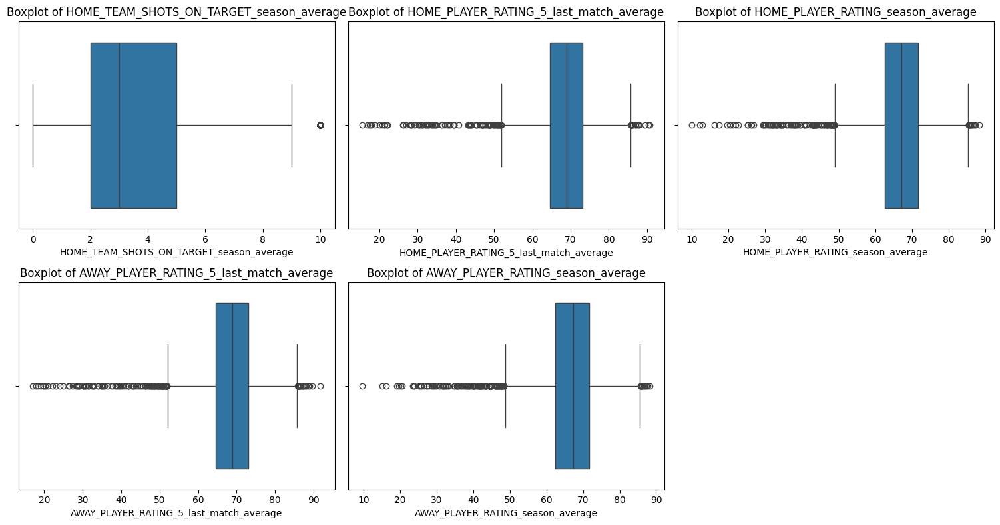

In [154]:
def plot_boxplots_for_outliers(df, outlier_columns):
    plt.figure(figsize=(15, 8))
    for i, column in enumerate(outlier_columns, 1):
        plt.subplot(2, len(outlier_columns) // 2 + 1, i)  # Adjust the layout for better presentation
        sns.boxplot(x=df[column])
        plt.title(f'Boxplot of {column}')
    plt.tight_layout()
    plt.show()
plot_boxplots_for_outliers(train_data_with_ratings, outlier_columns)

Based on our data understanding, we decided to **keep and consider** the following columns with apparent outliers:

- `HOME_TEAM_SHOTS_ON_TARGET_season_average`
- `HOME_PLAYER_RATING_5_last_match_average`
- `HOME_PLAYER_RATING_season_average`
- `AWAY_PLAYER_RATING_5_last_match_average`
- `AWAY_PLAYER_RATING_season_average`

Although these columns show values that could be interpreted as outliers, we assessed that these features are significant for the model, providing important insights into player and team performance. Removing them could result in losing valuable information for predicting match outcomes or player performance. Therefore, we opted to retain them and treat them as part of the data for the modeling process.

### 4. Checking Corrolation

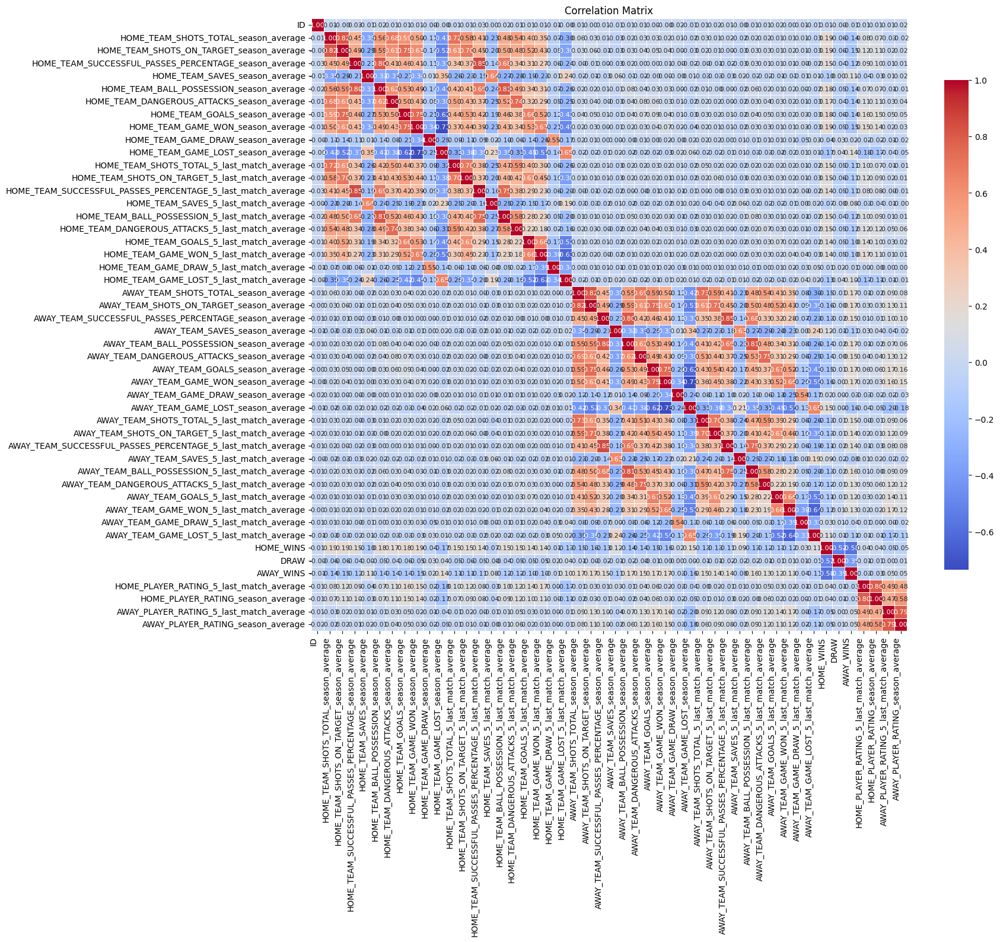

In [155]:
corr_matrix = train_data_with_ratings.corr()

# Set up the matplotlib figure with a larger size
plt.figure(figsize=(18, 16))  # Adjusted size for 45 features

# Draw the heatmap with larger annotations and a rotated label
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', linewidths=0.5, 
            annot_kws={"size": 8}, cbar_kws={'shrink': 0.8})

# Adjust the x and y labels to prevent overlap
plt.xticks(rotation=90, ha='right')
plt.yticks(rotation=0)

# Display the plot
plt.title('Correlation Matrix')
plt.tight_layout()
plt.show()

In [277]:
correlation_matrix = train_data.corr()
correlation_threshold = 0.7
correlation_pairs = correlation_matrix.unstack()
high_correlation_pairs = correlation_pairs[
    (correlation_pairs > correlation_threshold) & (correlation_pairs < 1.0)
].sort_values(ascending=False)
print("High Correlations (>|{:.2f}|):".format(correlation_threshold))
for (col1, col2), value in high_correlation_pairs.items():
    print(f"{col1} - {col2}: {value:.2f}")

High Correlations (>|0.70|):
AWAY_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average - AWAY_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average: 0.85
AWAY_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average - AWAY_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average: 0.85
HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average - HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average: 0.85
HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average - HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average: 0.85
HOME_TEAM_BALL_POSSESSION_season_average - HOME_TEAM_BALL_POSSESSION_5_last_match_average: 0.81
HOME_TEAM_BALL_POSSESSION_5_last_match_average - HOME_TEAM_BALL_POSSESSION_season_average: 0.81
AWAY_TEAM_BALL_POSSESSION_season_average - AWAY_TEAM_BALL_POSSESSION_5_last_match_average: 0.80
AWAY_TEAM_BALL_POSSESSION_5_last_match_average - AWAY_TEAM_BALL_POSSESSION_season_average: 0.80
HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average - HOME_TEAM_BALL_POSSESSION_season_average: 0

## Modeling 🧠

We trained models on three different processed versions of the data to evaluate which approach provides the best performance:

1. **DATA 1**: Using the original data with many features.
2. **DATA 2**: Using a reduced feature set without imputation.
3. **DATA 3**: Using a reduced feature set with imputation.

By comparing the performance of these models, we aim to determine which data preprocessing strategy leads to the best predictive accuracy.

### 1. DATA WITH ALL FEATURES

In [278]:
train_data_with_ratings.shape

(10689, 48)

In [279]:
train_data_with_ratings.columns

Index(['ID', 'HOME_TEAM_SHOTS_TOTAL_season_average',
       'HOME_TEAM_SHOTS_ON_TARGET_season_average',
       'HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average',
       'HOME_TEAM_SAVES_season_average',
       'HOME_TEAM_BALL_POSSESSION_season_average',
       'HOME_TEAM_DANGEROUS_ATTACKS_season_average',
       'HOME_TEAM_GOALS_season_average', 'HOME_TEAM_GAME_WON_season_average',
       'HOME_TEAM_GAME_DRAW_season_average',
       'HOME_TEAM_GAME_LOST_season_average',
       'HOME_TEAM_SHOTS_TOTAL_5_last_match_average',
       'HOME_TEAM_SHOTS_ON_TARGET_5_last_match_average',
       'HOME_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average',
       'HOME_TEAM_SAVES_5_last_match_average',
       'HOME_TEAM_BALL_POSSESSION_5_last_match_average',
       'HOME_TEAM_DANGEROUS_ATTACKS_5_last_match_average',
       'HOME_TEAM_GOALS_5_last_match_average',
       'HOME_TEAM_GAME_WON_5_last_match_average',
       'HOME_TEAM_GAME_DRAW_5_last_match_average',
       'HOME_TEAM_GAME_LOST_

In [280]:
target_columns = ['HOME_WINS', 'DRAW', 'AWAY_WINS']
X = train_data_with_ratings.drop(columns=target_columns)  # Features

In [281]:
X = X.drop(columns=['ID'])

In [207]:
# Create a new target column based on the three original columns
y = np.argmax(train_data_with_ratings[target_columns].values, axis=1)  # Convert to a single column with 0, 1, or 2
y_series = pd.Series(y, name='target')
y_series

0        2
1        1
2        2
3        0
4        1
5        0
6        0
7        1
8        0
9        1
10       0
11       2
12       1
13       0
14       0
15       0
16       0
17       1
18       0
19       1
20       0
21       2
22       2
23       1
24       1
25       1
26       2
27       0
28       0
29       2
30       2
31       0
32       2
33       0
34       0
35       0
36       1
37       0
38       0
39       0
40       0
41       2
42       0
43       1
44       0
45       0
46       1
47       0
48       1
49       1
50       0
51       2
52       0
53       1
54       1
55       1
56       2
57       0
58       0
59       1
60       0
61       1
62       0
63       0
64       0
65       2
66       2
67       0
68       0
69       2
70       1
71       0
72       2
73       1
74       0
75       1
76       1
77       2
78       2
79       0
80       2
81       0
82       2
83       1
84       0
85       0
86       2
87       1
88       2
89       2
90       0

In this modeling step, we aim to transform the existing categorical columns `HOME_WINS`, `DRAW`, and `AWAY_WINS` into a single target variable `y` for model training. These columns represent the outcomes of a match, with values indicating the number of wins for home teams, draws, or away teams.

To simplify the target variable for modeling purposes, we used `np.argmax` to convert the three columns into a single numeric value representing the outcome of the match:

- `0` for home wins
- `1` for a draw
- `2` for away wins

In [282]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
# Define the hyperparameter grid
param_grid = {
    'hidden_layer_sizes': [(128, 64)],
    'activation': ['logistic'],
    'solver': ['sgd'],
    'learning_rate_init': [0.001],
    'max_iter': [1000]
}

# Define the model
mlp = MLPClassifier(random_state=42)

# Set up GridSearchCV
grid_search = GridSearchCV(estimator=mlp, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2)

# Fit the grid search
grid_search.fit(X_train, y_train)

# Get the best parameters and accuracy
best_params = grid_search.best_params_
best_accuracy = grid_search.best_score_

# Test the best model on the test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)

# Display results
print(f"Best Neural Network Configuration: {best_params}")
print(f"Best Validation Accuracy: {best_accuracy:.4f}")

# Classification report
print("\nClassification Report on Test Set:")
print(classification_report(y_test, y_pred))


Fitting 3 folds for each of 1 candidates, totalling 3 fits
[CV] END activation=logistic, hidden_layer_sizes=(128, 64), learning_rate_init=0.001, max_iter=1000, solver=sgd; total time=  17.1s
[CV] END activation=logistic, hidden_layer_sizes=(128, 64), learning_rate_init=0.001, max_iter=1000, solver=sgd; total time=  22.2s
[CV] END activation=logistic, hidden_layer_sizes=(128, 64), learning_rate_init=0.001, max_iter=1000, solver=sgd; total time=  18.8s
Best Neural Network Configuration: {'activation': 'logistic', 'hidden_layer_sizes': (128, 64), 'learning_rate_init': 0.001, 'max_iter': 1000, 'solver': 'sgd'}
Best Validation Accuracy: 0.4980

Classification Report on Test Set:
              precision    recall  f1-score   support

           0       0.48      0.81      0.60       903
           1       0.00      0.00      0.00       552
           2       0.49      0.45      0.47       683

    accuracy                           0.49      2138
   macro avg       0.32      0.42      0.36  

Random Forest Test Accuracy: 0.4818

Classification Report:
               precision    recall  f1-score   support

           0       0.48      0.79      0.60       903
           1       0.35      0.04      0.07       552
           2       0.50      0.43      0.46       683

    accuracy                           0.48      2138
   macro avg       0.44      0.42      0.38      2138
weighted avg       0.45      0.48      0.42      2138



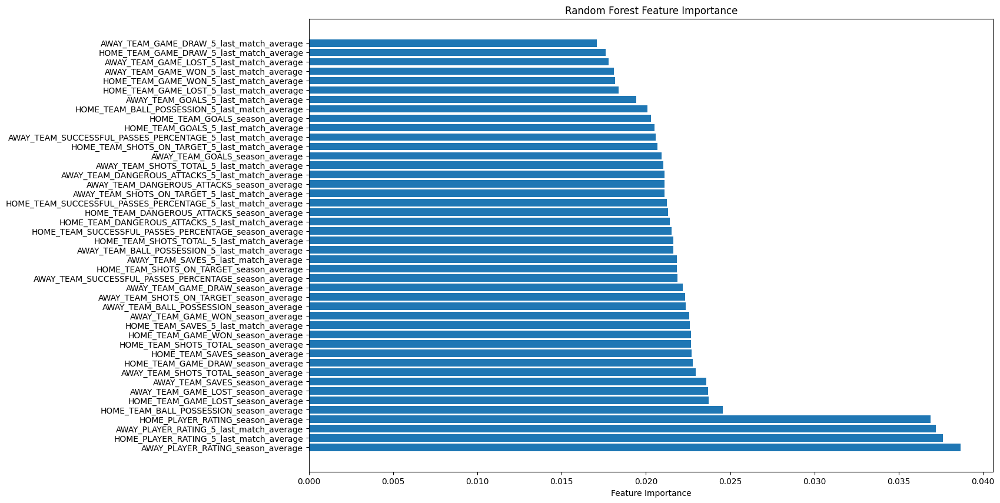

In [87]:
# Define the Random Forest model with pre-tuned parameters
rf = RandomForestClassifier(
    n_estimators=200,       # Reasonable number of trees
    max_depth=20,           # Limit depth to prevent overfitting
    min_samples_split=5,    # Minimum samples required to split
    min_samples_leaf=2,     # Minimum samples per leaf
    max_features='sqrt',    # Square root of features for split
    random_state=42         # For reproducibility
)

# Train the model
rf.fit(X_train, y_train)

# Make predictions on the test set
y_pred_rf = rf.predict(X_test)

# Evaluate the performance
accuracy_rf = accuracy_score(y_test, y_pred_rf)
print(f"Random Forest Test Accuracy: {accuracy_rf:.4f}")
print("\nClassification Report:\n", classification_report(y_test, y_pred_rf))

# Plotting feature importance
importances = rf.feature_importances_
indices = np.argsort(importances)[::-1]  # Sort feature importance in descending order

# Create the plot
plt.figure(figsize=(15, 10))
plt.title("Random Forest Feature Importance")
plt.barh(range(X_train.shape[1]), importances[indices], align="center")
plt.yticks(range(X_train.shape[1]), [X_train.columns[i] for i in indices])  # Feature names
plt.xlabel("Feature Importance")
plt.show()

XGBoost Test Accuracy: 0.4794

Classification Report:
               precision    recall  f1-score   support

           0       0.49      0.76      0.60       903
           1       0.32      0.04      0.07       552
           2       0.47      0.46      0.47       683

    accuracy                           0.48      2138
   macro avg       0.43      0.42      0.38      2138
weighted avg       0.44      0.48      0.42      2138



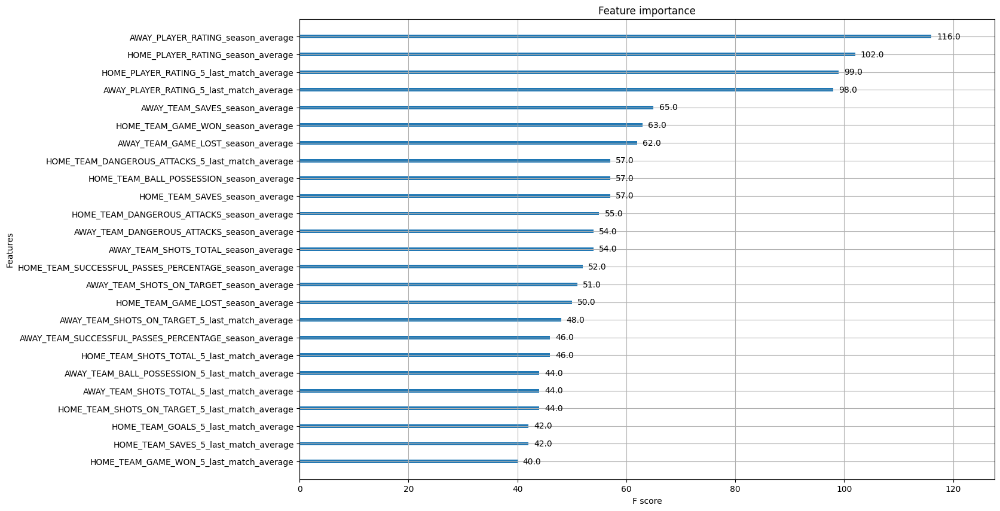

In [88]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, random_state=42)
# Initialize the XGBoost classifier with predefined parameters
xgb_model = xgb.XGBClassifier(
    learning_rate=0.1,    # Learning rate
    max_depth=3,          # Maximum depth of a tree
    n_estimators=100,     # Number of trees
    subsample=0.8,        # Fraction of samples for training each tree
    colsample_bytree=0.8, # Fraction of features for training each tree
    gamma=1,              # Minimum loss reduction for split
    reg_alpha=0.1,        # L1 regularization
    reg_lambda=10,        # L2 regularization
    use_label_encoder=False,
    eval_metric='mlogloss',
    random_state=42       # For reproducibility
)

# Train the model
xgb_model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = xgb_model.predict(X_test)
y_pred_proba = xgb_model.predict_proba(X_test)  # Probabilities

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"XGBoost Test Accuracy: {accuracy:.4f}")
print("\nClassification Report:\n", classification_report(y_test, y_pred))

# Plot the feature importance
xgb.plot_importance(xgb_model, max_num_features=25, importance_type='weight')
plt.gcf().set_size_inches(15, 10)
plt.show()

Fitting 2 folds for each of 6 candidates, totalling 12 fits
Logistic Regression Test Accuracy: 0.4944

Classification Report:
               precision    recall  f1-score   support

           0       0.50      0.80      0.61       903
           1       0.31      0.02      0.03       552
           2       0.50      0.48      0.49       683

    accuracy                           0.49      2138
   macro avg       0.44      0.43      0.38      2138
weighted avg       0.45      0.49      0.42      2138


Best Parameters from GridSearchCV:
{'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}


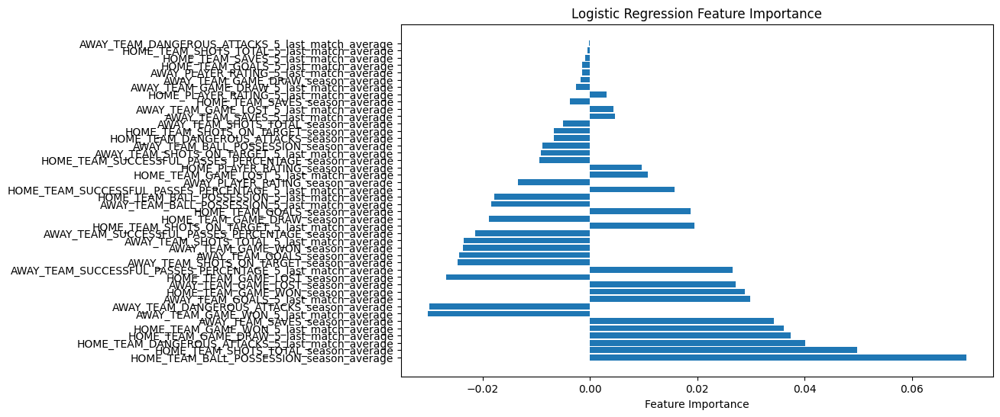

In [89]:
# Define the Logistic Regression model
log_reg = LogisticRegression(max_iter=1000, random_state=42)

# Define the hyperparameter grid for Grid Search
param_grid = {
    'C': [0.1, 1, 10],            # Inverse of regularization strength
    'solver': ['liblinear', 'saga'],  # Use 'liblinear' and 'saga' solvers for optimization
    'penalty': ['l2'],           # Regularization term
}

# Perform Grid Search with 2-fold cross-validation (for faster results)
grid_search = GridSearchCV(estimator=log_reg, param_grid=param_grid, cv=2, n_jobs=-1, verbose=1)

# Fit the model using Grid Search
grid_search.fit(X_train, y_train)

# Get the best model from the grid search
best_log_reg = grid_search.best_estimator_

# Make predictions on the test set
y_pred = best_log_reg.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"Logistic Regression Test Accuracy: {accuracy:.4f}")
print("\nClassification Report:\n", classification_report(y_test, y_pred))

# Print best parameters from GridSearchCV
print("\nBest Parameters from GridSearchCV:")
print(grid_search.best_params_)

# Get the feature importance (coefficients)
feature_importance = best_log_reg.coef_[0]

# Get feature names (assuming X is a pandas DataFrame)
feature_names = X.columns

# Sort feature importance in descending order
sorted_idx = np.argsort(np.abs(feature_importance))[::-1]

# Plot the feature importance
plt.figure(figsize=(10, 6))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), feature_names[sorted_idx])
plt.xlabel('Feature Importance')
plt.title('Logistic Regression Feature Importance')
plt.show()

In [90]:
# Update Random Forest model with class weighting
rf_model = RandomForestClassifier(random_state=42, class_weight='balanced')

# Use the same parameter grid
param_grid = {
    'n_estimators': [50, 100],
    'max_depth': [10, 20, None],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 4]
}

# Set up GridSearchCV with the updated model
grid_search = GridSearchCV(estimator=rf_model, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2)
grid_search.fit(X_train, y_train)

# Evaluate the best model
best_rf_model = grid_search.best_estimator_
y_pred = best_rf_model.predict(X_test)

# Print results
print("Best Parameters:", grid_search.best_params_)
print("\nPerformance of the Best Random Forest Model with Class Weights:")
print(classification_report(y_test, y_pred))

accuracy = grid_search.best_score_
print(f"Best Validation Accuracy: {accuracy:.4f}")


Fitting 3 folds for each of 24 candidates, totalling 72 fits
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   0.4s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   0.3s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   0.3s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.8s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.8s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.8s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=5, n_estimators=50; total time=   0.3s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=5, n_estimators=50; total time=   0.3s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=5, n_estimators=50; total time=   0.3s
[CV] END max_depth=10, min_samples_l

In [91]:
# Standardize the data
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Define the custom wrapper for Keras Model
class KerasNN(BaseEstimator, ClassifierMixin):
    def __init__(self, units=64, activation='relu', batch_size=32, epochs=20):
        self.units = units
        self.activation = activation
        self.batch_size = batch_size
        self.epochs = epochs
        self.model = None

    def create_nn(self):
        model = Sequential()
        model.add(Dense(self.units, input_dim=X_train.shape[1], activation=self.activation))
        model.add(Dense(self.units//2, activation=self.activation))
        model.add(Dense(3, activation='softmax'))  # 3 classes for classification
        model.compile(optimizer=optimizers.Adam(), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
        return model

    def fit(self, X, y):
        self.model = self.create_nn()
        self.model.fit(X, y, batch_size=self.batch_size, epochs=self.epochs, verbose=0)
        return self

    def predict(self, X):
        return np.argmax(self.model.predict(X), axis=1)

# Define models and hyperparameter grids
models = {
    "MLPClassifier": {
        "model": MLPClassifier(random_state=42),
        "param_grid": {
            'hidden_layer_sizes': [(50,), (100,), (50, 50)],
            'activation': ['relu', 'tanh'],
            'solver': ['adam', 'sgd'],
            'learning_rate': ['constant', 'adaptive'],
            'max_iter': [200, 500]
        }
    },
    "Keras NN": {
        "model": KerasNN(),
        "param_grid": {
            'batch_size': [32, 64],
            'epochs': [20, 50],
            'units': [32, 64],
            'activation': ['relu', 'tanh']
        }
    }
}

# Iterate through models and perform grid search
best_model = None
best_accuracy = 0
best_params = None

for model_name, model_info in models.items():
    print(f"Training {model_name}...")
    grid_search = GridSearchCV(estimator=model_info["model"], param_grid=model_info["param_grid"], cv=3, scoring='accuracy', verbose=2, n_jobs=-1)
    grid_search.fit(X_train, y_train)
    
    best_model_found = grid_search.best_estimator_
    y_pred = best_model_found.predict(X_test)
    
    print(f"\nBest Parameters for {model_name}: {grid_search.best_params_}")
    print(f"\nPerformance of the Best {model_name} Model:")
    print(classification_report(y_test, y_pred))
    
    accuracy = grid_search.best_score_
    print(f"Best Validation Accuracy for {model_name}: {accuracy:.4f}")
    
    # Update if this model gives better performance
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model = best_model_found
        best_params = grid_search.best_params_

# Best model performance
print("\nBest Model Overall:")
print(f"Best Accuracy: {best_accuracy:.4f}")
print(f"Best Parameters: {best_params}")

Training MLPClassifier...
Fitting 3 folds for each of 48 candidates, totalling 144 fits

Best Parameters for MLPClassifier: {'activation': 'tanh', 'hidden_layer_sizes': (50,), 'learning_rate': 'constant', 'max_iter': 200, 'solver': 'sgd'}

Performance of the Best MLPClassifier Model:
              precision    recall  f1-score   support

           0       0.49      0.76      0.60       903
           1       0.25      0.05      0.08       552
           2       0.50      0.46      0.48       683

    accuracy                           0.48      2138
   macro avg       0.41      0.42      0.39      2138
weighted avg       0.43      0.48      0.43      2138

Best Validation Accuracy for MLPClassifier: 0.4900
Training Keras NN...
Fitting 3 folds for each of 16 candidates, totalling 48 fits
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step

Best Parameters for Keras NN: {'activation': 'tanh', 'batch_size': 64, 'epochs': 20, 'units': 32}

Performance of the Best Keras NN Model:
              precisio

### 2. DATA WITH REDUCING FEATURE (Without Imputation)

In [159]:
def add_total_matches_to_data(dataframe):
    # Calculate total matches played in the season
    dataframe['HOME_TOTAL_MATCHES'] = (
        dataframe['HOME_TEAM_GAME_WON_season_average'] +
        dataframe['HOME_TEAM_GAME_DRAW_season_average'] +
        dataframe['HOME_TEAM_GAME_LOST_season_average']
    )
    
    dataframe['AWAY_TOTAL_MATCHES'] = (
        dataframe['AWAY_TEAM_GAME_WON_season_average'] +
        dataframe['AWAY_TEAM_GAME_DRAW_season_average'] +
        dataframe['AWAY_TEAM_GAME_LOST_season_average']
    )
    
    # Calculate total matches played in the last 5 matches
    dataframe['HOME_TOTAL_MATCHES_5_MATCHES'] = (
        dataframe['HOME_TEAM_GAME_WON_5_last_match_average'] +
        dataframe['HOME_TEAM_GAME_DRAW_5_last_match_average'] +
        dataframe['HOME_TEAM_GAME_LOST_5_last_match_average']
    )
    
    dataframe['AWAY_TOTAL_MATCHES_5_MATCHES'] = (
        dataframe['AWAY_TEAM_GAME_WON_5_last_match_average'] +
        dataframe['AWAY_TEAM_GAME_DRAW_5_last_match_average'] +
        dataframe['AWAY_TEAM_GAME_LOST_5_last_match_average']
    )
    
    return dataframe
# Add total matches to the dataset
train_data_with_ratings = add_total_matches_to_data(train_data_with_ratings)
# Display the updated data to verify
print("Preview of data with total matches added (season and last 5 matches):")
print(train_data_with_ratings[['HOME_TOTAL_MATCHES', 'AWAY_TOTAL_MATCHES',
                               'HOME_TOTAL_MATCHES_5_MATCHES', 'AWAY_TOTAL_MATCHES_5_MATCHES']].head())


Preview of data with total matches added (season and last 5 matches):
   HOME_TOTAL_MATCHES  AWAY_TOTAL_MATCHES  HOME_TOTAL_MATCHES_5_MATCHES  \
0                16.0                11.0                          12.0   
1                11.0                11.0                          11.0   
2                10.0                12.0                          11.0   
3                17.0                13.0                          12.0   
4                12.0                10.0                          14.0   

   AWAY_TOTAL_MATCHES_5_MATCHES  
0                          12.0  
1                          12.0  
2                          11.0  
3                          11.0  
4                          13.0  


In [160]:
test_data_with_ratings = add_total_matches_to_data(test_data_with_ratings)

# Display the updated data to verify
print("Preview of data with total matches added (season and last 5 matches):")
print(test_data_with_ratings[['HOME_TOTAL_MATCHES', 'AWAY_TOTAL_MATCHES',
                               'HOME_TOTAL_MATCHES_5_MATCHES', 'AWAY_TOTAL_MATCHES_5_MATCHES']].head())

train_data_with_means_imputation = add_total_matches_to_data(train_data_with_means_imputation)

Preview of data with total matches added (season and last 5 matches):
   HOME_TOTAL_MATCHES  AWAY_TOTAL_MATCHES  HOME_TOTAL_MATCHES_5_MATCHES  \
0                14.0                15.0                          13.0   
1                10.0                 9.0                          13.0   
2                14.0                11.0                          14.0   
3                13.0                13.0                          14.0   
4                11.0                14.0                          13.0   

   AWAY_TOTAL_MATCHES_5_MATCHES  
0                          13.0  
1                          12.0  
2                          14.0  
3                          14.0  
4                          13.0  


In [161]:
def calculate_average_points_per_match(dataframe):
    # Ensure total matches columns exist
    if 'HOME_TOTAL_MATCHES' not in dataframe.columns or 'AWAY_TOTAL_MATCHES' not in dataframe.columns:
        raise ValueError("The columns HOME_TOTAL_MATCHES and AWAY_TOTAL_MATCHES must be present in the dataframe.")

    # Calculate total points for the home and away teams (season data)
    dataframe['HOME_TOTAL_POINTS'] = (
        dataframe['HOME_TEAM_GAME_WON_season_average'] * 10 +
        dataframe['HOME_TEAM_GAME_DRAW_season_average']* 5
    )
    dataframe['AWAY_TOTAL_POINTS'] = (
        dataframe['AWAY_TEAM_GAME_WON_season_average'] * 10 +
        dataframe['AWAY_TEAM_GAME_DRAW_season_average']* 5
    )

    # Calculate total points for the last 5 matches
    dataframe['HOME_TOTAL_POINTS_5_MATCHES'] = (
        dataframe['HOME_TEAM_GAME_WON_5_last_match_average'] * 10 +
        dataframe['HOME_TEAM_GAME_DRAW_5_last_match_average']* 5
    )
    dataframe['AWAY_TOTAL_POINTS_5_MATCHES'] = (
        dataframe['AWAY_TEAM_GAME_WON_5_last_match_average'] * 10 +
        dataframe['AWAY_TEAM_GAME_DRAW_5_last_match_average']* 5
    )

    # Calculate average points per match for home and away teams (season data)
    dataframe['HOME_AVG_POINTS_PER_MATCH'] = dataframe['HOME_TOTAL_POINTS'] / dataframe['HOME_TOTAL_MATCHES']
    dataframe['AWAY_AVG_POINTS_PER_MATCH'] = dataframe['AWAY_TOTAL_POINTS'] / dataframe['AWAY_TOTAL_MATCHES']

    # Calculate average points per match for last 5 matches
    dataframe['HOME_AVG_POINTS_5_MATCHES'] = dataframe['HOME_TOTAL_POINTS_5_MATCHES'] / dataframe['HOME_TOTAL_MATCHES_5_MATCHES']
    dataframe['AWAY_AVG_POINTS_5_MATCHES'] = dataframe['AWAY_TOTAL_POINTS_5_MATCHES'] / dataframe['AWAY_TOTAL_MATCHES_5_MATCHES']

    # Drop the used columns
    columns_to_drop = [
        'HOME_TEAM_GAME_WON_season_average',
        'HOME_TEAM_GAME_DRAW_season_average',
        'HOME_TEAM_GAME_LOST_season_average',
        'AWAY_TEAM_GAME_WON_season_average',
        'AWAY_TEAM_GAME_DRAW_season_average',
        'AWAY_TEAM_GAME_LOST_season_average',
        'HOME_TEAM_GAME_WON_5_last_match_average',
        'HOME_TEAM_GAME_DRAW_5_last_match_average',
        'HOME_TEAM_GAME_LOST_5_last_match_average',
        'AWAY_TEAM_GAME_WON_5_last_match_average',
        'AWAY_TEAM_GAME_DRAW_5_last_match_average',
        'AWAY_TEAM_GAME_LOST_5_last_match_average',
        'HOME_TOTAL_POINTS',
        'AWAY_TOTAL_POINTS',
        'HOME_TOTAL_POINTS_5_MATCHES',
        'AWAY_TOTAL_POINTS_5_MATCHES'
    ]
    dataframe = dataframe.drop(columns=columns_to_drop)

    return dataframe

# Apply the function
train_data_with_ratings = calculate_average_points_per_match(train_data_with_ratings)

# Display the first few rows of the updated dataframe
print("Preview of the data with average points per match columns:")
print(train_data_with_ratings[['HOME_AVG_POINTS_PER_MATCH', 'AWAY_AVG_POINTS_PER_MATCH', 
                               'HOME_AVG_POINTS_5_MATCHES', 'AWAY_AVG_POINTS_5_MATCHES']].head())

Preview of the data with average points per match columns:
   HOME_AVG_POINTS_PER_MATCH  AWAY_AVG_POINTS_PER_MATCH  \
0                   2.187500                   6.818182   
1                   7.727273                   2.272727   
2                   2.000000                   3.750000   
3                   7.058824                   2.692308   
4                   4.166667                   6.000000   

   HOME_AVG_POINTS_5_MATCHES  AWAY_AVG_POINTS_5_MATCHES  
0                   1.666667                   5.833333  
1                   8.636364                   2.916667  
2                   3.636364                   2.727273  
3                   7.916667                   2.727273  
4                   3.571429                   4.230769  


In [162]:
test_data_with_ratings = calculate_average_points_per_match(test_data_with_ratings)

# Display the first few rows of the updated dataframe
print("Preview of the data with average points per match columns:")
print(test_data_with_ratings[['HOME_AVG_POINTS_PER_MATCH', 'AWAY_AVG_POINTS_PER_MATCH', 
                               'HOME_AVG_POINTS_5_MATCHES', 'AWAY_AVG_POINTS_5_MATCHES']].head())

train_data_with_means_imputation = calculate_average_points_per_match(train_data_with_means_imputation)

Preview of the data with average points per match columns:
   HOME_AVG_POINTS_PER_MATCH  AWAY_AVG_POINTS_PER_MATCH  \
0                   1.428571                   4.000000   
1                   5.000000                   8.888889   
2                   8.571429                   5.000000   
3                   8.461538                   6.153846   
4                   4.545455                   5.000000   

   HOME_AVG_POINTS_5_MATCHES  AWAY_AVG_POINTS_5_MATCHES  
0                   1.153846                   1.153846  
1                   5.769231                   7.916667  
2                   6.785714                   3.214286  
3                   4.642857                   3.571429  
4                   7.692308                   6.153846  


To reduce the number of features in the dataset while retaining valuable information, we created new columns representing the average points per match for both home and away teams. The goal was to simplify the data while still preserving the key performance indicators for the teams. This was achieved by calculating the average points for both the season and the last 5 matches based on existing data.

The steps involved in creating these new columns are as follows:

1. **Season Data Calculation**: 
   - We calculated the total points for home and away teams based on the number of games won and drawn in the season (using a 10-point scale for wins and 5 for draws).
   - The total points were then divided by the total number of matches played by the team to obtain the average points per match for the season.

2. **Last 5 Matches Calculation**: 
   - Similarly, we calculated the total points for home and away teams based on their performance in the last 5 matches.
   - This total was divided by the number of matches played in the last 5 games to obtain the average points per match over this period.

3. **Feature Reduction**: 
   - After calculating the average points per match, we dropped the original, more granular features related to wins, draws, and losses over both the entire season and the last 5 matches. 
   - This helped reduce the feature space and focus on the most relevant features for the modeling process.

The new columns created are:
- `HOME_AVG_POINTS_PER_MATCH`: Average points per match for home teams based on the entire season.
- `AWAY_AVG_POINTS_PER_MATCH`: Average points per match for away teams based on the entire season.
- `HOME_AVG_POINTS_5_MATCHES`: Average points per match for home teams based on the last 5 matches.
- `AWAY_AVG_POINTS_5_MATCHES`: Average points per match for away teams based on the last 5 matches.

This feature reduction approach helps simplify the dataset while retaining the essential performance data needed for model training.

In [163]:
def create_difference_features_and_remove_originals(dataframe, target_columns):
    # List to keep track of new column names
    difference_columns = []
    columns_to_drop = []

    # Loop through all columns
    for home_col in dataframe.columns:
        if home_col.startswith("HOME_") and home_col not in target_columns:
            # Derive the corresponding AWAY column
            feature_name = home_col.replace("HOME_", "")
            away_col = f"AWAY_{feature_name}"

            # Check if the corresponding AWAY column exists and is not a target column
            if away_col in dataframe.columns and away_col not in target_columns:
                # Compute the difference and add as a new column
                diff_col = f"DIFF_{feature_name}"
                dataframe[diff_col] = dataframe[home_col] - dataframe[away_col]
                difference_columns.append(diff_col)

                # Track the columns to drop later
                columns_to_drop.extend([home_col, away_col])

    # Drop the original HOME_ and AWAY_ columns
    dataframe = dataframe.drop(columns=columns_to_drop)

    print(f"Created difference columns: {difference_columns}")
    print(f"Dropped columns: {columns_to_drop}")
    return dataframe

# Example Usage
# Assuming `train_data_with_ratings` is your dataset and `target_columns` is the list of target columns
target_columns = ['HOME_WINS', 'DRAW', 'AWAY_WINS']  # Specify the target columns
train_data_with_diffs = create_difference_features_and_remove_originals(train_data_with_ratings, target_columns)
# Display the first few rows of the updated dataframe
print(train_data_with_diffs.head())

Created difference columns: ['DIFF_TEAM_SHOTS_TOTAL_season_average', 'DIFF_TEAM_SHOTS_ON_TARGET_season_average', 'DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average', 'DIFF_TEAM_SAVES_season_average', 'DIFF_TEAM_BALL_POSSESSION_season_average', 'DIFF_TEAM_DANGEROUS_ATTACKS_season_average', 'DIFF_TEAM_GOALS_season_average', 'DIFF_TEAM_SHOTS_TOTAL_5_last_match_average', 'DIFF_TEAM_SHOTS_ON_TARGET_5_last_match_average', 'DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average', 'DIFF_TEAM_SAVES_5_last_match_average', 'DIFF_TEAM_BALL_POSSESSION_5_last_match_average', 'DIFF_TEAM_DANGEROUS_ATTACKS_5_last_match_average', 'DIFF_TEAM_GOALS_5_last_match_average', 'DIFF_PLAYER_RATING_5_last_match_average', 'DIFF_PLAYER_RATING_season_average', 'DIFF_TOTAL_MATCHES', 'DIFF_TOTAL_MATCHES_5_MATCHES', 'DIFF_AVG_POINTS_PER_MATCH', 'DIFF_AVG_POINTS_5_MATCHES']
Dropped columns: ['HOME_TEAM_SHOTS_TOTAL_season_average', 'AWAY_TEAM_SHOTS_TOTAL_season_average', 'HOME_TEAM_SHOTS_ON_TARGET_season_average

In [164]:
test_data_with_diffs = create_difference_features_and_remove_originals(test_data_with_ratings, target_columns)
# Display the first few rows of the updated dataframe
print(test_data_with_diffs.head())

train_data_with_means_imputation = create_difference_features_and_remove_originals(train_data_with_means_imputation, target_columns)

Created difference columns: ['DIFF_TEAM_SHOTS_TOTAL_season_average', 'DIFF_TEAM_SHOTS_ON_TARGET_season_average', 'DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average', 'DIFF_TEAM_SAVES_season_average', 'DIFF_TEAM_BALL_POSSESSION_season_average', 'DIFF_TEAM_DANGEROUS_ATTACKS_season_average', 'DIFF_TEAM_GOALS_season_average', 'DIFF_TEAM_SHOTS_TOTAL_5_last_match_average', 'DIFF_TEAM_SHOTS_ON_TARGET_5_last_match_average', 'DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average', 'DIFF_TEAM_SAVES_5_last_match_average', 'DIFF_TEAM_BALL_POSSESSION_5_last_match_average', 'DIFF_TEAM_DANGEROUS_ATTACKS_5_last_match_average', 'DIFF_TEAM_GOALS_5_last_match_average', 'DIFF_PLAYER_RATING_5_last_match_average', 'DIFF_PLAYER_RATING_season_average', 'DIFF_TOTAL_MATCHES', 'DIFF_TOTAL_MATCHES_5_MATCHES', 'DIFF_AVG_POINTS_PER_MATCH', 'DIFF_AVG_POINTS_5_MATCHES']
Dropped columns: ['HOME_TEAM_SHOTS_TOTAL_season_average', 'AWAY_TEAM_SHOTS_TOTAL_season_average', 'HOME_TEAM_SHOTS_ON_TARGET_season_average

In [289]:
test_data_with_diffs.shape

(25368, 21)

In [290]:
train_data_with_diffs.shape

(10689, 24)

In [165]:
def apply_weighted_sum_for_features(dataframe):
    # List of season and last 5 matches feature pairs
    season_features = [
        'DIFF_TEAM_SHOTS_TOTAL_season_average',
        'DIFF_TEAM_SHOTS_ON_TARGET_season_average',
        'DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_season_average',
        'DIFF_TEAM_SAVES_season_average',
        'DIFF_TEAM_BALL_POSSESSION_season_average',
        'DIFF_TEAM_DANGEROUS_ATTACKS_season_average',
        'DIFF_TEAM_GOALS_season_average',
        'DIFF_PLAYER_RATING_season_average',
        'DIFF_AVG_POINTS_PER_MATCH',
    ]

    last_5_features = [
        'DIFF_TEAM_SHOTS_TOTAL_5_last_match_average',
        'DIFF_TEAM_SHOTS_ON_TARGET_5_last_match_average',
        'DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_5_last_match_average',
        'DIFF_TEAM_SAVES_5_last_match_average',
        'DIFF_TEAM_BALL_POSSESSION_5_last_match_average',
        'DIFF_TEAM_DANGEROUS_ATTACKS_5_last_match_average',
        'DIFF_TEAM_GOALS_5_last_match_average',
        'DIFF_PLAYER_RATING_5_last_match_average',
        'DIFF_AVG_POINTS_5_MATCHES',
    ]
    
    # Combine each feature using the weighted sum
    for season_feature, last_5_feature in zip(season_features, last_5_features):
        # Create a new feature name by appending "_weighted" to the base feature name
        new_feature_name = f"{season_feature.replace('_season_average', '').replace('_PER_MATCH', '')}_weighted"
        dataframe[new_feature_name] = (
            0.7 * dataframe[season_feature] + 
            0.3 * dataframe[last_5_feature]
        )
    
    # Drop the original season and last 5 match features (optional)
    features_to_drop = season_features + last_5_features + ['DIFF_TOTAL_MATCHES', 'DIFF_TOTAL_MATCHES_5_MATCHES']
    dataframe = dataframe.drop(columns=features_to_drop)
    
    return dataframe

# Apply the function to the dataset
train_data_with_diffs = apply_weighted_sum_for_features(train_data_with_diffs)

# Display the updated dataframe to verify
print("Preview of the data with weighted features:")
print(train_data_with_diffs.head())


Preview of the data with weighted features:
   ID  HOME_WINS  DRAW  AWAY_WINS  DIFF_TEAM_SHOTS_TOTAL_weighted  \
0   0          0     0          1                            -0.1   
1   1          0     1          0                             2.0   
2   2          0     0          1                            -0.6   
3   3          1     0          0                             3.7   
4   4          0     1          0                            -2.3   

   DIFF_TEAM_SHOTS_ON_TARGET_weighted  \
0                                 1.3   
1                                 3.3   
2                                 1.2   
3                                 5.8   
4                                -4.9   

   DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_weighted  DIFF_TEAM_SAVES_weighted  \
0                                             -3.3                      -1.3   
1                                              0.4                       0.1   
2                                             -3.7    

In [166]:
test_data_with_diffs = apply_weighted_sum_for_features(test_data_with_diffs)

# Display the updated dataframe to verify
print("Preview of the data with weighted features:")
print(test_data_with_diffs.head())

train_data_with_means_imputation = apply_weighted_sum_for_features(train_data_with_means_imputation)

Preview of the data with weighted features:
      ID  DIFF_TEAM_SHOTS_TOTAL_weighted  DIFF_TEAM_SHOTS_ON_TARGET_weighted  \
0  12303                            -2.8                                -5.2   
1  12304                            -0.1                                -3.2   
2  12305                             5.5                                 5.1   
3  12306                            -3.0                                -1.5   
4  12307                            -0.6                                -0.6   

   DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_weighted  DIFF_TEAM_SAVES_weighted  \
0                                              2.6                       0.2   
1                                             -7.3                      -0.2   
2                                              0.1                      -2.7   
3                                              0.7                       2.3   
4                                             -1.4                       0.

1. **Identify Feature Pairs**: 
   We selected pairs of features, one representing the season average and the other representing the average over the last 5 matches, for the following categories:
   - Shots, passes, saves, ball possession, dangerous attacks, goals, player ratings, and average points per match.

2. **Apply Weighted Sum**: 
   For each feature pair, we calculated the weighted sum as follows:
   - Season feature weighted by 0.7.
   - Last 5 matches feature weighted by 0.3.
   
   The result is a new feature that reflects the balance between the season performance and recent form.

3. **Create New Features**:
   We created new columns by appending "_weighted" to the feature names. This allows us to clearly identify the transformed features in the dataset.

4. **Drop Original Features**:
   After creating the weighted sum features, we dropped the original season and last 5 match features to reduce the dimensionality of the dataset and focus on the new, combined features.

In [78]:
test_data_with_diffs.shape

(25368, 10)

In [79]:
train_data_with_diffs.shape

(10689, 13)

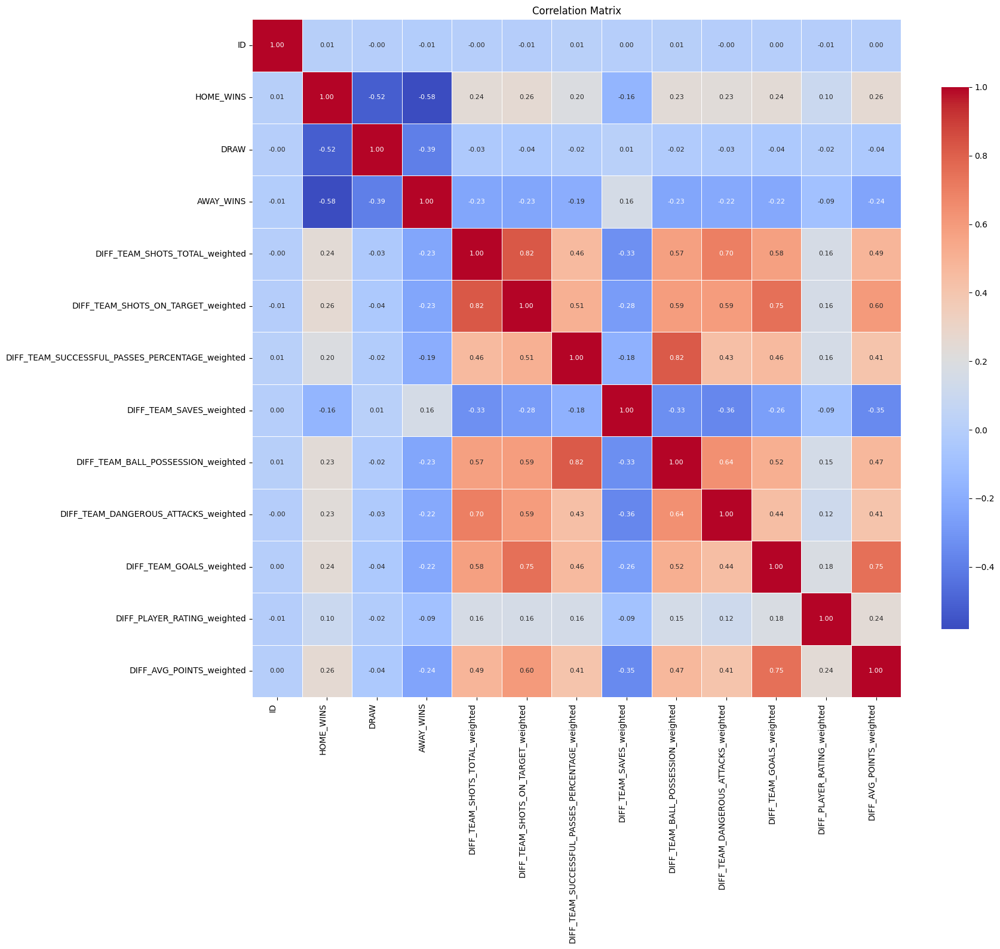

In [168]:
corr_matrix = train_data_with_diffs.corr()

# Set up the matplotlib figure with a larger size
plt.figure(figsize=(18, 16))  # Adjusted size for 45 features

# Draw the heatmap with larger annotations and a rotated label
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', linewidths=0.5, 
            annot_kws={"size": 8}, cbar_kws={'shrink': 0.8})

# Adjust the x and y labels to prevent overlap
plt.xticks(rotation=90, ha='right')
plt.yticks(rotation=0)

# Display the plot
plt.title('Correlation Matrix')
plt.tight_layout()
plt.show()

### 3. DATA WITH REDUCING FEATURE (Without Imputation BUT WITH ADDING A FEATURE TO TRY TO DETECT DRAW GAMES)

In [304]:
train_data_with_diffs.head()

,ID,HOME_WINS,DRAW,AWAY_WINS,DIFF_TEAM_SHOTS_TOTAL_weighted,DIFF_TEAM_SHOTS_ON_TARGET_weighted,DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_weighted,DIFF_TEAM_SAVES_weighted,DIFF_TEAM_BALL_POSSESSION_weighted,DIFF_TEAM_DANGEROUS_ATTACKS_weighted,DIFF_TEAM_GOALS_weighted,DIFF_PLAYER_RATING_weighted,DIFF_AVG_POINTS_weighted
0,0,0,0,1,-0.1,1.3,-3.3,-1.3,-2.3,0.0,-0.7,-1.679926,-4.491477
1,1,0,1,0,2.0,3.3,0.4,0.1,1.4,-1.0,7.3,4.804641,5.534091
2,2,0,0,1,-0.6,1.2,-3.7,1.0,-4.7,-3.3,-0.8,-11.070000,-0.952273
3,3,1,0,0,3.7,5.8,3.1,-3.6,4.1,0.6,4.7,1.485000,4.613379
4,4,0,1,0,-2.3,-4.9,-1.0,0.7,-3.0,-1.0,-5.0,4.291250,-1.481136


In [305]:
draw_data = train_data_with_diffs[train_data_with_diffs['DRAW'] == 1]

In [306]:
summary = draw_data.describe()
print(summary)

                 ID  HOME_WINS    DRAW  AWAY_WINS  \
count   2770.000000     2770.0  2770.0     2770.0   
mean    6142.195307        0.0     1.0        0.0   
std     3546.096719        0.0     0.0        0.0   
min        1.000000        0.0     1.0        0.0   
25%     3086.000000        0.0     1.0        0.0   
50%     6093.500000        0.0     1.0        0.0   
75%     9246.500000        0.0     1.0        0.0   
max    12295.000000        0.0     1.0        0.0   

       DIFF_TEAM_SHOTS_TOTAL_weighted  DIFF_TEAM_SHOTS_ON_TARGET_weighted  \
count                     2770.000000                         2770.000000   
mean                        -0.337329                           -0.366065   
std                          3.326249                            3.266813   
min                        -10.000000                          -10.000000   
25%                         -2.400000                           -2.400000   
50%                         -0.400000                       

In [173]:
win_home_data = train_data_with_diffs[train_data_with_diffs['HOME_WINS'] == 1]

In [307]:
summary = win_home_data.describe()
# Display the summary
print(summary)

                 ID  HOME_WINS    DRAW  AWAY_WINS  \
count   4647.000000     4647.0  4647.0     4647.0   
mean    6181.650097        1.0     0.0        0.0   
std     3571.786268        0.0     0.0        0.0   
min        3.000000        1.0     0.0        0.0   
25%     3043.500000        1.0     0.0        0.0   
50%     6225.000000        1.0     0.0        0.0   
75%     9295.000000        1.0     0.0        0.0   
max    12302.000000        1.0     0.0        0.0   

       DIFF_TEAM_SHOTS_TOTAL_weighted  DIFF_TEAM_SHOTS_ON_TARGET_weighted  \
count                     4647.000000                         4647.000000   
mean                         0.873983                            0.949172   
std                          3.498656                            3.541521   
min                        -10.000000                          -10.000000   
25%                         -1.600000                           -1.300000   
50%                          0.900000                       

In [308]:
win_away_data = train_data_with_diffs[train_data_with_diffs['AWAY_WINS'] == 1]
summary = win_away_data.describe()
# Display the summary
print(summary)

                 ID  HOME_WINS    DRAW  AWAY_WINS  \
count   3272.000000     3272.0  3272.0     3272.0   
mean    6100.782396        0.0     0.0        1.0   
std     3509.616077        0.0     0.0        0.0   
min        0.000000        0.0     0.0        1.0   
25%     3119.000000        0.0     0.0        1.0   
50%     6079.000000        0.0     0.0        1.0   
75%     9123.750000        0.0     0.0        1.0   
max    12300.000000        0.0     0.0        1.0   

       DIFF_TEAM_SHOTS_TOTAL_weighted  DIFF_TEAM_SHOTS_ON_TARGET_weighted  \
count                     3272.000000                         3272.000000   
mean                        -1.383221                           -1.363539   
std                          3.568134                            3.526853   
min                        -10.000000                          -10.000000   
25%                         -3.800000                           -3.700000   
50%                         -1.300000                       

In [309]:
draw_data = train_data_with_diffs[train_data_with_diffs['DRAW'] == 1]
# Calculate the 25th and 75th percentiles only on draw_data
quantiles_draw = draw_data.quantile([0.25, 0.75])

# Function to check if at least 5 features are within the 25th-75th percentile range based on draw_data quantiles
def check_possible_draw_full(row):
    count_in_range = 0
    for col in draw_data.columns:
        if col not in ['ID', 'DRAW', 'HOME_WINS', 'AWAY_WINS']:  # Exclude target and ID columns
            if quantiles_draw.loc[0.25, col] <= row[col] <= quantiles_draw.loc[0.75, col]:
                count_in_range += 1
        if count_in_range >= 6:  # If at least 5 features are in range, return 1
            return 1
    return 0  # If fewer than 5 features are in range, return 0

# Apply the function to the entire train_data_with_diffs dataset
train_data_with_diffs['POSSIBLE_DRAW'] = train_data_with_diffs.apply(check_possible_draw_full, axis=1)

# Display the updated DataFrame
print(train_data_with_diffs.head())

# Check the distribution of the new column
print(train_data_with_diffs['POSSIBLE_DRAW'].value_counts())

   ID  HOME_WINS  DRAW  AWAY_WINS  DIFF_TEAM_SHOTS_TOTAL_weighted  \
0   0          0     0          1                            -0.1   
1   1          0     1          0                             2.0   
2   2          0     0          1                            -0.6   
3   3          1     0          0                             3.7   
4   4          0     1          0                            -2.3   

   DIFF_TEAM_SHOTS_ON_TARGET_weighted  \
0                                 1.3   
1                                 3.3   
2                                 1.2   
3                                 5.8   
4                                -4.9   

   DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_weighted  DIFF_TEAM_SAVES_weighted  \
0                                             -3.3                      -1.3   
1                                              0.4                       0.1   
2                                             -3.7                       1.0   
3                 

In [310]:
# Calculate the 25th and 75th percentiles for the draw_data in the training set
quantiles_draw = draw_data.quantile([0.25, 0.75])

# Function to check if at least 6 features are within the 25th-75th percentile range based on draw_data quantiles
def check_possible_draw(row, quantiles):
    count_in_range = 0
    for col in quantiles.columns:
        if col not in ['ID', 'DRAW', 'HOME_WINS', 'AWAY_WINS']:  # Exclude target and ID columns
            if quantiles.loc[0.25, col] <= row[col] <= quantiles.loc[0.75, col]:
                count_in_range += 1
        if count_in_range >= 6:  # If at least 6 features are in range, return 1
            return 1
    return 0  # If fewer than 6 features are in range, return 0

# Apply the function to the training data
train_data_with_diffs['POSSIBLE_DRAW'] = train_data_with_diffs.apply(lambda row: check_possible_draw(row, quantiles_draw), axis=1)

# Save the quantiles for future use (e.g., saving to a file or applying to the test data)
quantiles_draw.to_csv("quantiles_draw_train.csv", index=True)
print("Quantiles saved as 'quantiles_draw_train.csv'.")

# Load quantiles for testing (or use the previously saved variable)
quantiles_draw_test = pd.read_csv("quantiles_draw_train.csv", index_col=0)

# Apply the function to the test data
test_data_with_diffs['POSSIBLE_DRAW'] = test_data_with_diffs.apply(lambda row: check_possible_draw(row, quantiles_draw_test), axis=1)

# Display the updated test DataFrame
print(test_data_with_diffs.head())

# Check the distribution of the new column in the test set
print(test_data_with_diffs['POSSIBLE_DRAW'].value_counts())


Quantiles saved as 'quantiles_draw_train.csv'.
      ID  DIFF_TEAM_SHOTS_TOTAL_weighted  DIFF_TEAM_SHOTS_ON_TARGET_weighted  \
0  12303                            -2.8                                -5.2   
1  12304                            -0.1                                -3.2   
2  12305                             5.5                                 5.1   
3  12306                            -3.0                                -1.5   
4  12307                            -0.6                                -0.6   

   DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_weighted  DIFF_TEAM_SAVES_weighted  \
0                                              2.6                       0.2   
1                                             -7.3                      -0.2   
2                                              0.1                      -2.7   
3                                              0.7                       2.3   
4                                             -1.4                      

In [311]:
test_data_with_diffs.head()

,ID,DIFF_TEAM_SHOTS_TOTAL_weighted,DIFF_TEAM_SHOTS_ON_TARGET_weighted,DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_weighted,DIFF_TEAM_SAVES_weighted,DIFF_TEAM_BALL_POSSESSION_weighted,DIFF_TEAM_DANGEROUS_ATTACKS_weighted,DIFF_TEAM_GOALS_weighted,DIFF_PLAYER_RATING_weighted,DIFF_AVG_POINTS_weighted,POSSIBLE_DRAW
0,12303,-2.8,-5.2,2.6,0.2,2.3,-0.7,-1.5,-7.213889,-1.800000,0
1,12304,-0.1,-3.2,-7.3,-0.2,-5.7,-1.1,-4.7,2.645098,-3.366453,0
2,12305,5.5,5.1,0.1,-2.7,2.0,7.9,4.6,0.372024,3.571429,0
3,12306,-3.0,-1.5,0.7,2.3,0.1,-8.2,-0.9,1.203268,1.936813,1
4,12307,-0.6,-0.6,-1.4,0.3,-0.3,-2.6,2.7,4.273603,0.143357,1


In [312]:
target_columns = ['HOME_WINS', 'DRAW', 'AWAY_WINS']
X = train_data_with_diffs.drop(columns=target_columns)  # Features

In [313]:
X.drop(columns=["ID"], inplace=True)

In [314]:
X.head()

,DIFF_TEAM_SHOTS_TOTAL_weighted,DIFF_TEAM_SHOTS_ON_TARGET_weighted,DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_weighted,DIFF_TEAM_SAVES_weighted,DIFF_TEAM_BALL_POSSESSION_weighted,DIFF_TEAM_DANGEROUS_ATTACKS_weighted,DIFF_TEAM_GOALS_weighted,DIFF_PLAYER_RATING_weighted,DIFF_AVG_POINTS_weighted,POSSIBLE_DRAW
0,-0.1,1.3,-3.3,-1.3,-2.3,0.0,-0.7,-1.679926,-4.491477,1
1,2.0,3.3,0.4,0.1,1.4,-1.0,7.3,4.804641,5.534091,0
2,-0.6,1.2,-3.7,1.0,-4.7,-3.3,-0.8,-11.070000,-0.952273,0
3,3.7,5.8,3.1,-3.6,4.1,0.6,4.7,1.485000,4.613379,0
4,-2.3,-4.9,-1.0,0.7,-3.0,-1.0,-5.0,4.291250,-1.481136,0


In [315]:
# Create a new target column based on the three original columns
y = np.argmax(train_data_with_diffs[target_columns].values, axis=1)  # Convert to a single column with 0, 1, or 2

In [316]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [122]:
# Define models and hyperparameter grids
models = {
    "Logistic Regression": {
        "model": LogisticRegression(multi_class='ovr', max_iter=1000, random_state=42),
        "param_grid": {
            'C': [0.1, 1, 10],
            'solver': ['liblinear', 'saga'],
            'penalty': ['l1', 'l2'],
            'max_iter': [1000]
        }
    },
    "Random Forest": {
        "model": RandomForestClassifier(random_state=42),
        "param_grid": {
            'n_estimators': [50, 100],
            'max_depth': [10, 20, None],
            'min_samples_split': [2, 5],
            'min_samples_leaf': [1, 4]
        }
    },
    "SVM": {
        "model": SVC(kernel='linear', random_state=42),
        "param_grid": {
            'C': [0.1, 1, 10],
            'gamma': ['scale', 'auto'],
            'kernel': ['linear', 'rbf']
        }
    },
    "Gradient Boosting": {
        "model": GradientBoostingClassifier(random_state=42),
        "param_grid": {
            'n_estimators': [50, 100],
            'learning_rate': [0.05, 0.1],
            'max_depth': [3, 6, 10]
        }
    }
}

# Iterate through models and perform grid search
best_model = None
best_accuracy = 0
best_params = None

for model_name, model_info in models.items():
    print(f"Training {model_name}...")
    grid_search = GridSearchCV(estimator=model_info["model"], param_grid=model_info["param_grid"], cv=3, scoring='accuracy', verbose=2, n_jobs=-1)
    grid_search.fit(X_train, y_train)
    
    best_model_found = grid_search.best_estimator_
    y_pred = best_model_found.predict(X_test)
    
    print(f"\nBest Parameters for {model_name}: {grid_search.best_params_}")
    print(f"\nPerformance of the Best {model_name} Model:")
    print(classification_report(y_test, y_pred))
    
    accuracy = grid_search.best_score_
    print(f"Best Validation Accuracy for {model_name}: {accuracy:.4f}")
    
    # Update if this model gives better performance
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model = best_model_found
        best_params = grid_search.best_params_

# Best model performance
print("\nBest Model Overall:")
print(f"Best Accuracy: {best_accuracy:.4f}")
print(f"Best Parameters: {best_params}")

Training Logistic Regression...
Fitting 3 folds for each of 12 candidates, totalling 36 fits

Best Parameters for Logistic Regression: {'C': 0.1, 'max_iter': 1000, 'penalty': 'l1', 'solver': 'saga'}

Performance of the Best Logistic Regression Model:
              precision    recall  f1-score   support

           0       0.49      0.81      0.61       445
           1       0.00      0.00      0.00       276
           2       0.49      0.46      0.48       348

    accuracy                           0.49      1069
   macro avg       0.33      0.43      0.36      1069
weighted avg       0.36      0.49      0.41      1069

Best Validation Accuracy for Logistic Regression: 0.4955
Training Random Forest...
Fitting 3 folds for each of 24 candidates, totalling 72 fits

Best Parameters for Random Forest: {'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 100}

Performance of the Best Random Forest Model:
              precision    recall  f1-score   support

 

In [177]:
# Step 1: Store the 'ID' column for later reattachment
if 'ID' in test_data_with_diffs.columns:
    test_ids = test_data_with_diffs['ID'].values  # Preserve original IDs
    # Drop 'ID' column from the test data
    merged_test_data_with_ratings = test_data_with_diffs.drop(columns=['ID'])
else:
    raise KeyError("The 'ID' column is missing from the test data!")

In [178]:
print("Stored ID values:", test_ids)

Stored ID values: [12303 12304 12305 ... 37668 37669 37670]


In [130]:
# Step 1: Handle missing values with SimpleImputer
imputer = SimpleImputer(strategy='mean')
X_test_imputed = imputer.fit_transform(merged_test_data_with_ratings)

# Step 2: Predict the class (0, 1, or 2) using the trained model
test_predictions = grid_search.predict(X_test_imputed)

# Step 3: Convert predicted classes into the required format
# Initialize a DataFrame with zeros
predictions = pd.DataFrame(0, index=range(len(test_predictions)), columns=['HOME_WINS', 'DRAW', 'AWAY_WINS'])

# Set the appropriate column to 1 based on the predicted class
for i, pred in enumerate(test_predictions):
    predictions.iloc[i, pred] = 1

# Step 4: Reattach the 'ID' column
predictions['ID'] = test_ids

# Step 5: Reorder columns to have 'ID' first
predictions = predictions[['ID', 'HOME_WINS', 'DRAW', 'AWAY_WINS']]

# Step 6: Save the submission file to CSV
predictions.to_csv('submission_mlp_with_ids.csv', index=False)

print("Submission file created: submission_mlp_with_ids.csv")

Submission file created: submission_mlp_with_ids.csv


In [131]:
# Step 3: Standardize the Features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Step 4: Define the MLP Model and GridSearch Parameters
mlp = MLPClassifier(max_iter=1000, random_state=42)

# Hyperparameters to tune
param_grid = {
    'hidden_layer_sizes': [(128, 64), (64, 32), (256, 128)],  # Different sizes of hidden layers
    'activation': ['relu', 'logistic'],  # Activation functions
    'learning_rate_init': [0.001, 0.0001],  # Learning rates
    'alpha': [0.0001, 0.001],  # L2 penalty (regularization)
}

# Step 5: Apply GridSearchCV to find the best model
grid_search = GridSearchCV(estimator=mlp, param_grid=param_grid, cv=3, n_jobs=-1, verbose=2, scoring='accuracy')
grid_search.fit(X_train_scaled, y_train)

# Step 6: Evaluate the Best Model
best_mlp = grid_search.best_estimator_
y_pred = best_mlp.predict(X_test_scaled)

# Step 7: Show the Classification Report
print("Best MLP Model:", grid_search.best_params_)
print("Classification Report on Test Set:")
print(classification_report(y_test, y_pred, target_names=['HOME_WINS', 'DRAW', 'AWAY_WINS']))


Fitting 3 folds for each of 24 candidates, totalling 72 fits
Best MLP Model: {'activation': 'logistic', 'alpha': 0.001, 'hidden_layer_sizes': (256, 128), 'learning_rate_init': 0.0001}
Classification Report on Test Set:
              precision    recall  f1-score   support

   HOME_WINS       0.48      0.82      0.61       445
        DRAW       0.00      0.00      0.00       276
   AWAY_WINS       0.50      0.45      0.48       348

    accuracy                           0.49      1069
   macro avg       0.33      0.43      0.36      1069
weighted avg       0.37      0.49      0.41      1069



In [132]:

# Step 1: Standardize the Features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Step 2: Define the SVM Model and GridSearch Parameters
svm = SVC(random_state=42)

# Hyperparameters to tune
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],  # Regularization parameter
    'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],  # Types of kernels
    'gamma': ['scale', 'auto'],  # Kernel coefficient
    'degree': [2, 3]  # Degree of the polynomial kernel function (for 'poly' kernel)
}

# Step 3: Apply GridSearchCV to find the best model
grid_search = GridSearchCV(estimator=svm, param_grid=param_grid, cv=3, n_jobs=-1, verbose=2, scoring='accuracy')
grid_search.fit(X_train_scaled, y_train)

# Step 4: Evaluate the Best Model
best_svm = grid_search.best_estimator_
y_pred = best_svm.predict(X_test_scaled)

# Step 5: Show the Classification Report
print("Best SVM Model:", grid_search.best_params_)
print("Classification Report on Test Set:")
print(classification_report(y_test, y_pred, target_names=['HOME_WINS', 'DRAW', 'AWAY_WINS']))

Fitting 3 folds for each of 80 candidates, totalling 240 fits
Best SVM Model: {'C': 0.1, 'degree': 2, 'gamma': 'scale', 'kernel': 'rbf'}
Classification Report on Test Set:
              precision    recall  f1-score   support

   HOME_WINS       0.47      0.88      0.61       445
        DRAW       0.00      0.00      0.00       276
   AWAY_WINS       0.52      0.35      0.42       348

    accuracy                           0.48      1069
   macro avg       0.33      0.41      0.34      1069
weighted avg       0.37      0.48      0.39      1069



In [133]:
# Step 1: Handle missing values with SimpleImputer
imputer = SimpleImputer(strategy='mean')
X_test_imputed = imputer.fit_transform(merged_test_data_with_ratings)

# Step 2: Predict the class (0, 1, or 2) using the trained model
test_predictions = grid_search.predict(X_test_imputed)

# Step 3: Convert predicted classes into the required format
# Initialize a DataFrame with zeros
predictions = pd.DataFrame(0, index=range(len(test_predictions)), columns=['HOME_WINS', 'DRAW', 'AWAY_WINS'])

# Set the appropriate column to 1 based on the predicted class
for i, pred in enumerate(test_predictions):
    predictions.iloc[i, pred] = 1

# Step 4: Reattach the 'ID' column
predictions['ID'] = test_ids

# Step 5: Reorder columns to have 'ID' first
predictions = predictions[['ID', 'HOME_WINS', 'DRAW', 'AWAY_WINS']]

# Step 6: Save the submission file to CSV
predictions.to_csv('submission_mlp_with_ids.csv', index=False)

print("Submission file created: submission_mlp_with_ids.csv")

Submission file created: submission_mlp_with_ids.csv


In [134]:
# Feature scaling
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define the SVM model
svm = SVC(kernel='rbf', probability=True, random_state=42)

# Define the hyperparameter grid
param_grid = {
    'C': [ 1],  # Regularization parameter
    'gamma': [0.001]  # Kernel coefficient
}

# Hyperparameter tuning using GridSearchCV
grid_search = GridSearchCV(estimator=svm, param_grid=param_grid, cv=5, scoring='accuracy', verbose=2)
grid_search.fit(X_train_scaled, y_train)

# Best model
best_svm = grid_search.best_estimator_
print("Best Hyperparameters:", grid_search.best_params_)

# Evaluate the best model on the test set
y_pred_svm = best_svm.predict(X_test_scaled)
accuracy_svm = accuracy_score(y_test, y_pred_svm)
conf_matrix_svm = confusion_matrix(y_test, y_pred_svm)
class_report_svm = classification_report(y_test, y_pred_svm)

# Print results
print("SVM Accuracy:", accuracy_svm)
print("Confusion Matrix:\n", conf_matrix_svm)
print("Classification Report:\n", class_report_svm)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV] END ...................................C=1, gamma=0.001; total time=  14.1s
[CV] END ...................................C=1, gamma=0.001; total time=  14.0s
[CV] END ...................................C=1, gamma=0.001; total time=  13.9s
[CV] END ...................................C=1, gamma=0.001; total time=  13.9s
[CV] END ...................................C=1, gamma=0.001; total time=  14.0s
Best Hyperparameters: {'C': 1, 'gamma': 0.001}
SVM Accuracy: 0.48175865294667913
Confusion Matrix:
 [[387   0  58]
 [214   0  62]
 [220   0 128]]
Classification Report:
               precision    recall  f1-score   support

           0       0.47      0.87      0.61       445
           1       0.00      0.00      0.00       276
           2       0.52      0.37      0.43       348

    accuracy                           0.48      1069
   macro avg       0.33      0.41      0.35      1069
weighted avg       0.36      0.48      0

In [135]:
# Step 1: Handle missing values with SimpleImputer
imputer = SimpleImputer(strategy='mean')
X_test_imputed = imputer.fit_transform(merged_test_data_with_ratings)

# Step 2: Predict the class (0, 1, or 2) using the trained model
test_predictions = best_svm.predict(X_test_imputed)

# Step 3: Convert predicted classes into the required format
# Initialize a DataFrame with zeros
predictions = pd.DataFrame(0, index=range(len(test_predictions)), columns=['HOME_WINS', 'DRAW', 'AWAY_WINS'])

# Set the appropriate column to 1 based on the predicted class
for i, pred in enumerate(test_predictions):
    predictions.iloc[i, pred] = 1

# Step 4: Reattach the 'ID' column
predictions['ID'] = test_ids

# Step 5: Reorder columns to have 'ID' first
predictions = predictions[['ID', 'HOME_WINS', 'DRAW', 'AWAY_WINS']]

# Step 6: Save the submission file to CSV
predictions.to_csv('submission_mlp_with_ids.csv', index=False)

print("Submission file created: submission_mlp_with_ids.csv")

Submission file created: submission_mlp_with_ids.csv


In [136]:

# Define the hyperparameter grid
param_grid = {
    'hidden_layer_sizes': [(128, 64)],
    'activation': ['logistic'],
    'solver': ['sgd'],
    'learning_rate_init': [0.001],
    'max_iter': [1000]
}

# Define the model
mlp = MLPClassifier(random_state=42)

# Set up GridSearchCV
grid_search = GridSearchCV(estimator=mlp, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2)

# Fit the grid search
grid_search.fit(X_train, y_train)

# Get the best parameters and accuracy
best_params = grid_search.best_params_
best_accuracy = grid_search.best_score_

# Test the best model on the test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)

# Display results
print(f"Best Neural Network Configuration: {best_params}")
print(f"Best Validation Accuracy: {best_accuracy:.4f}")

# Classification report
print("\nClassification Report on Test Set:")
print(classification_report(y_test, y_pred))

Fitting 3 folds for each of 1 candidates, totalling 3 fits
[CV] END activation=logistic, hidden_layer_sizes=(128, 64), learning_rate_init=0.001, max_iter=1000, solver=sgd; total time=  10.6s
[CV] END activation=logistic, hidden_layer_sizes=(128, 64), learning_rate_init=0.001, max_iter=1000, solver=sgd; total time=  10.5s
[CV] END activation=logistic, hidden_layer_sizes=(128, 64), learning_rate_init=0.001, max_iter=1000, solver=sgd; total time=   9.5s
Best Neural Network Configuration: {'activation': 'logistic', 'hidden_layer_sizes': (128, 64), 'learning_rate_init': 0.001, 'max_iter': 1000, 'solver': 'sgd'}
Best Validation Accuracy: 0.4921

Classification Report on Test Set:
              precision    recall  f1-score   support

           0       0.50      0.80      0.61       445
           1       0.00      0.00      0.00       276
           2       0.49      0.50      0.50       348

    accuracy                           0.49      1069
   macro avg       0.33      0.43      0.37  

In [137]:
# Step 1: Handle missing values with SimpleImputer
imputer = SimpleImputer(strategy='mean')
X_test_imputed = imputer.fit_transform(merged_test_data_with_ratings)

# Step 2: Predict the class (0, 1, or 2) using the trained model
test_predictions = best_model_found.predict(X_test_imputed)

# Step 3: Convert predicted classes into the required format
# Initialize a DataFrame with zeros
predictions = pd.DataFrame(0, index=range(len(test_predictions)), columns=['HOME_WINS', 'DRAW', 'AWAY_WINS'])

# Set the appropriate column to 1 based on the predicted class
for i, pred in enumerate(test_predictions):
    predictions.iloc[i, pred] = 1

# Step 4: Reattach the 'ID' column
predictions['ID'] = test_ids

# Step 5: Reorder columns to have 'ID' first
predictions = predictions[['ID', 'HOME_WINS', 'DRAW', 'AWAY_WINS']]

# Step 6: Save the submission file to CSV
predictions.to_csv('submission_mlp_with_ids.csv', index=False)

print("Submission file created: submission_mlp_with_ids.csv")

Submission file created: submission_mlp_with_ids.csv


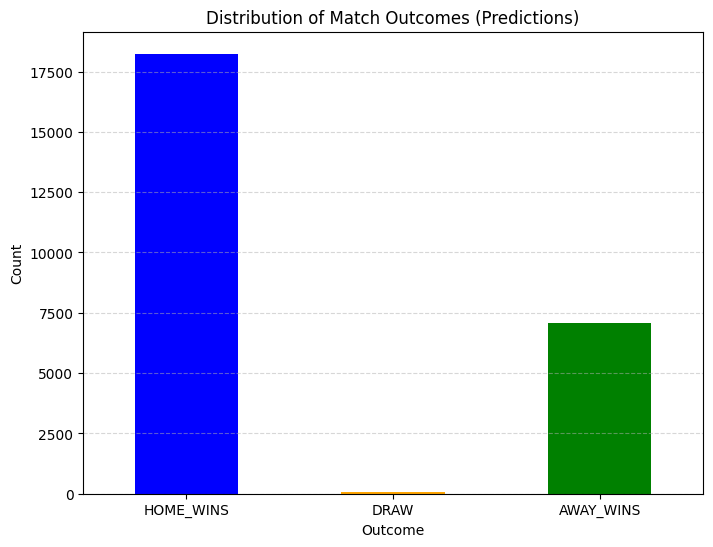

In [138]:
# Load the predictions file
predictions = pd.read_csv('submission_mlp_with_ids.csv')

# Count the occurrences of each outcome
outcome_counts = predictions[['HOME_WINS', 'DRAW', 'AWAY_WINS']].sum()

# Plot the distribution as a bar chart
plt.figure(figsize=(8, 6))
outcome_counts.plot(kind='bar', color=['blue', 'orange', 'green'])
plt.title('Distribution of Match Outcomes (Predictions)')
plt.xlabel('Outcome')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.show()


In [139]:
# Define and train the Logistic Regression model
model = LogisticRegression(max_iter=1000, random_state=42)
model.fit(X_train, y_train)

# Evaluate the model on the test set
y_pred = model.predict(X_test)
print("Classification Report on Test Set:")
print(classification_report(y_test, y_pred))

Classification Report on Test Set:
              precision    recall  f1-score   support

           0       0.49      0.81      0.61       445
           1       0.00      0.00      0.00       276
           2       0.49      0.46      0.47       348

    accuracy                           0.49      1069
   macro avg       0.33      0.42      0.36      1069
weighted avg       0.36      0.49      0.41      1069



In [140]:
# Define the parameter grid for Random Forest
param_grid = {
    'n_estimators': [50, 100],
    'max_depth': [10, 20, None],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 4]
}

# Initialize the Random Forest model
rf_model = RandomForestClassifier(random_state=42)

# Set up GridSearchCV
grid_search = GridSearchCV(estimator=rf_model, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2)
grid_search.fit(X_train, y_train)

# Get the best model and evaluate it on the test set
best_rf_model = grid_search.best_estimator_
y_pred = best_rf_model.predict(X_test)

# Display the classification report
print("Best Parameters:", grid_search.best_params_)
print("\nPerformance of the Best Random Forest Model:")
print(classification_report(y_test, y_pred))

# Calculate and print the accuracy
accuracy = grid_search.best_score_
print(f"Best Validation Accuracy: {accuracy:.4f}")

Fitting 3 folds for each of 24 candidates, totalling 72 fits
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   0.4s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   0.4s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   0.4s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.9s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.9s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.9s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=5, n_estimators=50; total time=   0.4s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=5, n_estimators=50; total time=   0.4s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=5, n_estimators=50; total time=   0.4s
[CV] END max_depth=10, min_samples_l

In [141]:
# Ensure the test dataset contains the 'ID' column
test_ids = test_data_with_diffs['ID'].values
X_test_final = test_data_with_diffs.drop(columns=['ID'])

# Predict the classes for the test dataset
test_predictions = best_rf_model.predict(X_test_final)

# Convert predictions to the required format
# Initialize a DataFrame with zeros
predictions = pd.DataFrame(0, index=range(len(test_predictions)), columns=['HOME_WINS', 'DRAW', 'AWAY_WINS'])

# Set the appropriate column to 1 based on the predicted class
for i, pred in enumerate(test_predictions):
    predictions.iloc[i, pred] = 1

# Add the 'ID' column back to the predictions DataFrame
predictions['ID'] = test_ids

# Reorder columns to have 'ID' first
predictions = predictions[['ID', 'HOME_WINS', 'DRAW', 'AWAY_WINS']]

# Save the predictions to a CSV file
predictions.to_csv('submission_rf.csv', index=False)

print("Submission file created: submission_rf.csv")

Submission file created: submission_rf.csv


In [184]:
# Initialize the Gradient Boosting Classifier
gb = GradientBoostingClassifier()

# Define the parameter grid
param_grid = {
    'learning_rate': [0.01, 0.05, 0.1],  # We can try small learning rates to avoid overfitting
    'max_depth': [3, 4, 5],               # Shallower trees to prevent overfitting
    'n_estimators': [50, 100],            # Reasonable values for number of estimators
    'subsample': [0.8, 0.9, 1.0],         # Test different subsample ratios
    'min_samples_split': [2, 5, 10]       # Prevent overfitting by limiting minimum split
}

# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=gb, param_grid=param_grid, cv=3, verbose=1, n_jobs=-1, scoring='accuracy')

# Fit the grid search
grid_search.fit(X_train, y_train)

# Get the best parameters and the best score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

# Output the best parameters and the best score
print(f"Best Parameters for Gradient Boosting: {best_params}")
print(f"Best Cross-Validation Accuracy: {best_score:.4f}")

# Train the best model on the full training set
best_gb_model = grid_search.best_estimator_

# Evaluate the best model on the test set
y_pred = best_gb_model.predict(X_test)


print("Performance of the Best Gradient Boosting Model:")
print(classification_report(y_test, y_pred))


Fitting 3 folds for each of 162 candidates, totalling 486 fits
Best Parameters for Gradient Boosting: {'learning_rate': 0.05, 'max_depth': 3, 'min_samples_split': 10, 'n_estimators': 100, 'subsample': 1.0}
Best Cross-Validation Accuracy: 0.4969
Performance of the Best Gradient Boosting Model:
              precision    recall  f1-score   support

           0       0.49      0.81      0.61       903
           1       0.38      0.02      0.04       552
           2       0.49      0.43      0.46       683

    accuracy                           0.49      2138
   macro avg       0.45      0.42      0.37      2138
weighted avg       0.46      0.49      0.42      2138



### 4. DATA WITH REDUCING FEATURE (With mean Imputation)

In [168]:
train_data_with_means_imputation.drop(columns=['DIFF_TEAM_INJURIES_5_last_match_average'], inplace=True)

In [ ]:
merged_test_data_with_ratings.drop(columns=['POSSIBLE_DRAW'], inplace=True)

In [169]:
train_data_with_means_imputation.head()

,ID,HOME_WINS,DRAW,AWAY_WINS,DIFF_TEAM_SHOTS_TOTAL_weighted,DIFF_TEAM_SHOTS_ON_TARGET_weighted,DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_weighted,DIFF_TEAM_SAVES_weighted,DIFF_TEAM_BALL_POSSESSION_weighted,DIFF_TEAM_DANGEROUS_ATTACKS_weighted,DIFF_TEAM_GOALS_weighted,DIFF_PLAYER_RATING_weighted,DIFF_AVG_POINTS_weighted
0,0.0,0.0,0.0,1.0,-0.1,1.3,-3.3,-1.3,-2.3,0.0,-0.7,-1.679926,-4.491477
1,1.0,0.0,1.0,0.0,2.0,3.3,0.4,0.1,1.4,-1.0,7.3,4.804641,5.534091
2,2.0,0.0,0.0,1.0,-0.6,1.2,-3.7,1.0,-4.7,-3.3,-0.8,-11.070000,-0.952273
3,3.0,1.0,0.0,0.0,3.7,5.8,3.1,-3.6,4.1,0.6,4.7,1.485000,4.613379
4,4.0,0.0,1.0,0.0,-2.3,-4.9,-1.0,0.7,-3.0,-1.0,-5.0,4.291250,-1.481136


In [170]:
train_data_with_means_imputation.shape

(12303, 13)

In [171]:
target_columns = ['HOME_WINS', 'DRAW', 'AWAY_WINS']

In [172]:
X = train_data_with_means_imputation.drop(columns=target_columns)  # Features
X.drop(columns=["ID"], inplace=True)
X.head()

,DIFF_TEAM_SHOTS_TOTAL_weighted,DIFF_TEAM_SHOTS_ON_TARGET_weighted,DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_weighted,DIFF_TEAM_SAVES_weighted,DIFF_TEAM_BALL_POSSESSION_weighted,DIFF_TEAM_DANGEROUS_ATTACKS_weighted,DIFF_TEAM_GOALS_weighted,DIFF_PLAYER_RATING_weighted,DIFF_AVG_POINTS_weighted
0,-0.1,1.3,-3.3,-1.3,-2.3,0.0,-0.7,-1.679926,-4.491477
1,2.0,3.3,0.4,0.1,1.4,-1.0,7.3,4.804641,5.534091
2,-0.6,1.2,-3.7,1.0,-4.7,-3.3,-0.8,-11.070000,-0.952273
3,3.7,5.8,3.1,-3.6,4.1,0.6,4.7,1.485000,4.613379
4,-2.3,-4.9,-1.0,0.7,-3.0,-1.0,-5.0,4.291250,-1.481136


In [173]:
# Create a new target column based on the three original columns
y = np.argmax(train_data_with_means_imputation[target_columns].values, axis=1)  # Convert to a single column with 0, 1, or 2

In [174]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
# Feature scaling
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define the SVM model
svm = SVC(kernel='rbf', probability=True, random_state=42)

# Define the hyperparameter grid
param_grid = {
    'C': [0.1, 1, 10, 100],  # Regularization parameter
    'gamma': ['scale', 'auto', 0.001, 0.01, 0.1, 1]  # Kernel coefficient
}

# Hyperparameter tuning using GridSearchCV
grid_search = GridSearchCV(estimator=svm, param_grid=param_grid, cv=5, scoring='accuracy', verbose=2)
grid_search.fit(X_train_scaled, y_train)

# Best model
best_svm = grid_search.best_estimator_
print("Best Hyperparameters:", grid_search.best_params_)

# Evaluate the best model on the test set
y_pred_svm = best_svm.predict(X_test_scaled)
accuracy_svm = accuracy_score(y_test, y_pred_svm)
conf_matrix_svm = confusion_matrix(y_test, y_pred_svm)
class_report_svm = classification_report(y_test, y_pred_svm)

# Print results
print("SVM Accuracy:", accuracy_svm)
print("Confusion Matrix:\n", conf_matrix_svm)
print("Classification Report:\n", class_report_svm)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV] END ...................................C=1, gamma=0.001; total time=  10.3s
[CV] END ...................................C=1, gamma=0.001; total time=  10.4s
[CV] END ...................................C=1, gamma=0.001; total time=  10.3s
[CV] END ...................................C=1, gamma=0.001; total time=  10.1s
[CV] END ...................................C=1, gamma=0.001; total time=  10.2s
Best Hyperparameters: {'C': 1, 'gamma': 0.001}
SVM Accuracy: 0.49695245835026414
Confusion Matrix:
 [[942   0 141]
 [484   0 136]
 [477   0 281]]
Classification Report:
               precision    recall  f1-score   support

           0       0.50      0.87      0.63      1083
           1       0.00      0.00      0.00       620
           2       0.50      0.37      0.43       758

    accuracy                           0.50      2461
   macro avg       0.33      0.41      0.35      2461
weighted avg       0.37      0.50      0

In [179]:
# Step 1: Handle missing values in the test data
imputer = SimpleImputer(strategy='mean')  # Replace missing values with column means
merged_test_data_imputed = imputer.fit_transform(merged_test_data_with_ratings)

# Step 2: Scale the imputed test data using the same scaler as training data
merged_test_data_scaled = scaler.transform(merged_test_data_imputed)

# Step 3: Predict the class labels (0, 1, or 2) using the trained SVM model
test_predictions = best_svm.predict(merged_test_data_scaled)

# Step 4: Convert predicted class indices to one-hot encoded format
predictions = pd.DataFrame(0, index=range(len(test_predictions)), columns=['HOME_WINS', 'DRAW', 'AWAY_WINS'])

for i, pred in enumerate(test_predictions):
    predictions.iloc[i, pred] = 1

# Step 5: Reattach the 'ID' column from the original test dataset
predictions['ID'] = test_ids

# Step 6: Reorder columns to match the required submission format
predictions = predictions[['ID', 'HOME_WINS', 'DRAW', 'AWAY_WINS']]

# Step 7: Save the predictions to a CSV file
predictions.to_csv('best_submission_svm.csv', index=False)

print("Submission file created: best_submission_svm.csv")

Submission file created: best_submission_svm.csv


In [181]:
# Define the Decision Tree model
decision_tree = DecisionTreeClassifier(random_state=42)

# Train the model
decision_tree.fit(X_train, y_train)

# Predict on the test data
y_pred_tree = decision_tree.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred_tree)
conf_matrix = confusion_matrix(y_test, y_pred_tree)
class_report = classification_report(y_test, y_pred_tree)

# Print results
print("Decision Tree Accuracy:", accuracy)
print("Confusion Matrix:\n", conf_matrix)
print("Classification Report:\n", class_report)

Decision Tree Accuracy: 0.37748882568061765
Confusion Matrix:
 [[525 266 292]
 [282 168 170]
 [279 243 236]]
Classification Report:
               precision    recall  f1-score   support

           0       0.48      0.48      0.48      1083
           1       0.25      0.27      0.26       620
           2       0.34      0.31      0.32       758

    accuracy                           0.38      2461
   macro avg       0.36      0.36      0.36      2461
weighted avg       0.38      0.38      0.38      2461



In [187]:
# Define the model
logistic = LogisticRegression(multi_class='multinomial', solver='lbfgs', random_state=42)

# Define the hyperparameter grid
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],       # Regularization strength
    'penalty': ['l2'],                  # Regularization type (L2)
    'max_iter': [100, 200, 300],        # Number of iterations for convergence
    'tol': [1e-4, 1e-3, 1e-2]           # Tolerance for stopping criteria
}

# Define the scoring metric (using F1 score for multi-class classification)
scorer = make_scorer(f1_score, average='weighted')

# Perform grid search
grid_search = GridSearchCV(
    estimator=logistic,
    param_grid=param_grid,
    cv=5,                              # Number of cross-validation folds
    scoring=scorer,                    # Scoring metric
    verbose=1                           # Verbosity level for progress
)

# Fit the grid search to the training data
grid_search.fit(X_train, y_train)

# Best model
best_logistic = grid_search.best_estimator_

# Evaluate on the test data
y_pred_logistic = best_logistic.predict(X_test)
print("Best Parameters:", grid_search.best_params_)
print("Logistic Regression F1 Score:", f1_score(y_test, y_pred_logistic, average='weighted'))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_logistic))
print("LogisticRegression Accuracy:", accuracy_score(y_test, y_pred_logistic))
print("Classification Report:\n", classification_report(y_test, y_pred_logistic))

Fitting 5 folds for each of 45 candidates, totalling 225 fits
Best Parameters: {'C': 1, 'max_iter': 100, 'penalty': 'l2', 'tol': 0.01}
Logistic Regression F1 Score: 0.4184736397611111
Confusion Matrix:
 [[869   1 213]
 [428   0 192]
 [404   0 354]]
LogisticRegression Accuracy: 0.49695245835026414
Classification Report:
               precision    recall  f1-score   support

           0       0.51      0.80      0.62      1083
           1       0.00      0.00      0.00       620
           2       0.47      0.47      0.47       758

    accuracy                           0.50      2461
   macro avg       0.33      0.42      0.36      2461
weighted avg       0.37      0.50      0.42      2461



In [325]:
# Initialize models
models = {
    "MLPClassifier": MLPClassifier(hidden_layer_sizes=(128, 64), activation='logistic', solver='sgd', max_iter=1000, random_state=42),
    "SVM": SVC(kernel='linear', random_state=42),
    "GaussianNB": GaussianNB(),
    "RandomForest": RandomForestClassifier(n_estimators=100, random_state=42)
}

# Train and evaluate each model
results = {}
for name, model in models.items():
    print(f"\nTraining {name}...")
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    print(f"Accuracy for {name}: {accuracy:.4f}")
    print(classification_report(y_test, y_pred))
    
    # Save results
    results[name] = {
        "model": model,
        "accuracy": accuracy,
        "classification_report": classification_report(y_test, y_pred, output_dict=True)
    }

# Save classification reports and predictions to CSV
for name, result in results.items():
    # Save classification report
    report_df = pd.DataFrame(result["classification_report"]).transpose()
    report_df.to_csv(f"{name}_classification_report.csv", index=True)
    print(f"Classification report for {name} saved as '{name}_classification_report.csv'.")

    # Save predictions
    predictions_df = pd.DataFrame({
        "True_Label": y_test,
        "Predicted_Label": result["model"].predict(X_test)
    })
    predictions_df.to_csv(f"{name}_predictions.csv", index=False)
    print(f"Predictions for {name} saved as '{name}_predictions.csv'.")



Training MLPClassifier...
Accuracy for MLPClassifier: 0.4933
              precision    recall  f1-score   support

           0       0.51      0.79      0.62      1083
           1       0.00      0.00      0.00       620
           2       0.46      0.47      0.47       758

    accuracy                           0.49      2461
   macro avg       0.32      0.42      0.36      2461
weighted avg       0.37      0.49      0.42      2461


Training SVM...
Accuracy for SVM: 0.4982
              precision    recall  f1-score   support

           0       0.50      0.83      0.63      1083
           1       0.00      0.00      0.00       620
           2       0.48      0.43      0.45       758

    accuracy                           0.50      2461
   macro avg       0.33      0.42      0.36      2461
weighted avg       0.37      0.50      0.42      2461


Training GaussianNB...
Accuracy for GaussianNB: 0.4681
              precision    recall  f1-score   support

           0       0.54

In [188]:
# Define the model
random_forest = RandomForestClassifier(random_state=42)

# Hyperparameter tuning
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [5, 10, 20],
    'min_samples_split': [2, 5, 10]
}
grid_search_rf = GridSearchCV(random_forest, param_grid, cv=5, scoring='accuracy')
grid_search_rf.fit(X_train, y_train)

# Best model
best_rf = grid_search_rf.best_estimator_

# Evaluate
y_pred_rf = best_rf.predict(X_test)
print("Random Forest Accuracy:", accuracy_score(y_test, y_pred_rf))
print(confusion_matrix(y_test, y_pred_rf))
print(classification_report(y_test, y_pred_rf))

Random Forest Accuracy: 0.4928890694839496
[[871  26 186]
 [434  19 167]
 [413  22 323]]
              precision    recall  f1-score   support

           0       0.51      0.80      0.62      1083
           1       0.28      0.03      0.06       620
           2       0.48      0.43      0.45       758

    accuracy                           0.49      2461
   macro avg       0.42      0.42      0.38      2461
weighted avg       0.44      0.49      0.43      2461



In [326]:
param_grid = {
    'C': [0.1],               # Regularization parameter
    'kernel': ['linear'],     # Kernels to try
    'gamma': ['scale']       # Kernel coefficient for 'rbf'
}

# Initialize the SVM model
svm = SVC(random_state=42)

# Set up GridSearchCV with 3-fold cross-validation
grid_search = GridSearchCV(estimator=svm, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search
grid_search.fit(X_train, y_train)

# Get the best parameters and accuracy
best_params = grid_search.best_params_
best_accuracy = grid_search.best_score_

# Test the best model on the test set
best_model_svm = grid_search.best_estimator_
y_pred = best_model_svm.predict(X_test)

# Display results
print(f"Best SVM Configuration: {best_params}")
print(f"Best Validation Accuracy: {best_accuracy:.4f}")

# Classification report and accuracy on test set
print("\nClassification Report on Test Set:")
print(classification_report(y_test, y_pred))
print(f"Test Accuracy: {accuracy_score(y_test, y_pred):.4f}")



Fitting 3 folds for each of 1 candidates, totalling 3 fits
Best SVM Configuration: {'C': 0.1, 'gamma': 'scale', 'kernel': 'linear'}
Best Validation Accuracy: 0.4893

Classification Report on Test Set:
              precision    recall  f1-score   support

           0       0.50      0.83      0.63      1083
           1       0.00      0.00      0.00       620
           2       0.48      0.43      0.45       758

    accuracy                           0.50      2461
   macro avg       0.33      0.42      0.36      2461
weighted avg       0.37      0.50      0.42      2461

Test Accuracy: 0.4982


In [332]:
# Step 1: Handle missing values with SimpleImputer
imputer = SimpleImputer(strategy='mean')
X_test_imputed = imputer.fit_transform(merged_test_data_with_ratings)

# Step 2: Predict the class (0, 1, or 2) using the trained model
test_predictions = best_model_svm.predict(X_test_imputed)

# Step 3: Convert predicted classes into the required format
# Initialize a DataFrame with zeros
predictions = pd.DataFrame(0, index=range(len(test_predictions)), columns=['HOME_WINS', 'DRAW', 'AWAY_WINS'])

# Set the appropriate column to 1 based on the predicted class
for i, pred in enumerate(test_predictions):
    predictions.iloc[i, pred] = 1

# Step 4: Reattach the 'ID' column
predictions['ID'] = test_ids

# Step 5: Reorder columns to have 'ID' first
predictions = predictions[['ID', 'HOME_WINS', 'DRAW', 'AWAY_WINS']]

# Step 6: Save the submission file to CSV
predictions.to_csv('best_model_svm.csv', index=False)

print("Submission file created: best_model_svm.csv")

Submission file created: best_model_svm.csv


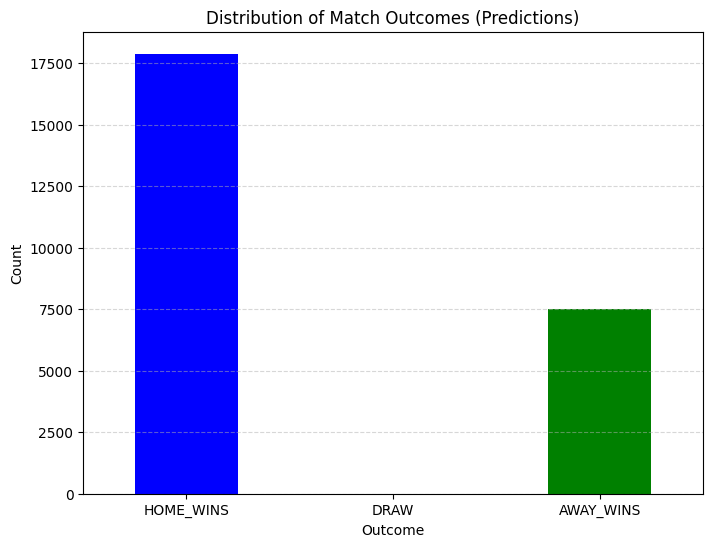

In [333]:
# Load the predictions file
predictions = pd.read_csv('best_model_svm.csv')

# Count the occurrences of each outcome
outcome_counts = predictions[['HOME_WINS', 'DRAW', 'AWAY_WINS']].sum()

# Plot the distribution as a bar chart
plt.figure(figsize=(8, 6))
outcome_counts.plot(kind='bar', color=['blue', 'orange', 'green'])
plt.title('Distribution of Match Outcomes (Predictions)')
plt.xlabel('Outcome')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.show()


In [334]:
# Define a hyperparameter grid for SVM
param_grid = {
    'C': [0.1, 1],               # Regularization parameter
    'kernel': ['linear', 'rbf'],     # Kernel types
    'gamma': ['scale'],      # Kernel coefficient for 'rbf'
    'class_weight': ['balanced']     # Class weights to handle imbalance
}

# Initialize the SVM model
svm = SVC(random_state=42)

# Set up GridSearchCV with 5-fold cross-validation
grid_search = GridSearchCV(estimator=svm, param_grid=param_grid, cv=5, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search
grid_search.fit(X_train, y_train)

# Get the best parameters and accuracy
best_params = grid_search.best_params_
best_accuracy = grid_search.best_score_

# Test the best model on the test set
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)

# Display results
print(f"Best SVM Configuration: {best_params}")
print(f"Best Validation Accuracy: {best_accuracy:.4f}")

# Classification report and accuracy on test set
print("\nClassification Report on Test Set:")
print(classification_report(y_test, y_pred))
print(f"Test Accuracy: {accuracy_score(y_test, y_pred):.4f}")


Fitting 5 folds for each of 4 candidates, totalling 20 fits
Best SVM Configuration: {'C': 1, 'class_weight': 'balanced', 'gamma': 'scale', 'kernel': 'linear'}
Best Validation Accuracy: 0.4647

Classification Report on Test Set:
              precision    recall  f1-score   support

           0       0.58      0.53      0.55      1083
           1       0.28      0.26      0.27       620
           2       0.44      0.52      0.48       758

    accuracy                           0.46      2461
   macro avg       0.43      0.44      0.43      2461
weighted avg       0.46      0.46      0.46      2461

Test Accuracy: 0.4575


In [335]:
# Initialize the Gradient Boosting model with best parameters
model = GradientBoostingClassifier(learning_rate=0.05, max_depth=3, n_estimators=50, random_state=42)

# Train the model
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
print(classification_report(y_test, y_pred))


              precision    recall  f1-score   support

           0       0.50      0.84      0.63      1083
           1       0.50      0.00      0.00       620
           2       0.48      0.41      0.44       758

    accuracy                           0.49      2461
   macro avg       0.49      0.42      0.36      2461
weighted avg       0.49      0.49      0.41      2461



In [336]:
# Initialize the Gradient Boosting model with the best parameters
modelGBC = GradientBoostingClassifier(
    learning_rate=0.05,
    max_depth=3,
    min_samples_leaf=2,
    min_samples_split=2,
    n_estimators=50,
    subsample=1.0,
    random_state=42
)

# Train the model
modelGBC.fit(X_train, y_train)

# Make predictions
y_pred = modelGBC.predict(X_test)

# Evaluate the model
print("Classification Report on Test Set:")
print(classification_report(y_test, y_pred))

Classification Report on Test Set:
              precision    recall  f1-score   support

           0       0.50      0.83      0.63      1083
           1       0.50      0.00      0.00       620
           2       0.48      0.41      0.44       758

    accuracy                           0.49      2461
   macro avg       0.49      0.42      0.36      2461
weighted avg       0.49      0.49      0.41      2461



In [337]:
# Step 1: Handle missing values with SimpleImputer
imputer = SimpleImputer(strategy='mean')
X_test_imputed = imputer.fit_transform(merged_test_data_with_ratings)

# Step 2: Predict the class (0, 1, or 2) using the trained model
test_predictions = modelGBC.predict(X_test_imputed)

# Step 3: Convert predicted classes into the required format
# Initialize a DataFrame with zeros
predictions = pd.DataFrame(0, index=range(len(test_predictions)), columns=['HOME_WINS', 'DRAW', 'AWAY_WINS'])

# Set the appropriate column to 1 based on the predicted class
for i, pred in enumerate(test_predictions):
    predictions.iloc[i, pred] = 1

# Step 4: Reattach the 'ID' column
predictions['ID'] = test_ids

# Step 5: Reorder columns to have 'ID' first
predictions = predictions[['ID', 'HOME_WINS', 'DRAW', 'AWAY_WINS']]

# Step 6: Save the submission file to CSV
predictions.to_csv('best_model_GB.csv', index=False)

print("Submission file created: best_model_GB.csv")

Submission file created: best_model_GB.csv


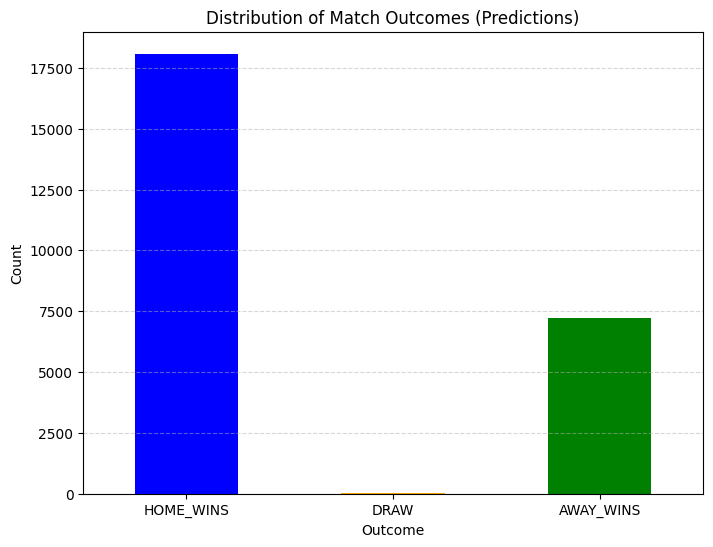

In [338]:
# Load the predictions file
predictions = pd.read_csv('best_model_GB.csv')

# Count the occurrences of each outcome
outcome_counts = predictions[['HOME_WINS', 'DRAW', 'AWAY_WINS']].sum()

# Plot the distribution as a bar chart
plt.figure(figsize=(8, 6))
outcome_counts.plot(kind='bar', color=['blue', 'orange', 'green'])
plt.title('Distribution of Match Outcomes (Predictions)')
plt.xlabel('Outcome')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.show()


## BONUS TRYING CLUSTERING (PCA/...)

In [340]:
train_data_with_diffs_pca = train_data_with_diffs.drop(columns=[ "HOME_WINS", "DRAW", "AWAY_WINS", "ID"])

In [341]:
train_data_with_diffs_pca.columns

Index(['DIFF_TEAM_SHOTS_TOTAL_weighted', 'DIFF_TEAM_SHOTS_ON_TARGET_weighted',
       'DIFF_TEAM_SUCCESSFUL_PASSES_PERCENTAGE_weighted',
       'DIFF_TEAM_SAVES_weighted', 'DIFF_TEAM_BALL_POSSESSION_weighted',
       'DIFF_TEAM_DANGEROUS_ATTACKS_weighted', 'DIFF_TEAM_GOALS_weighted',
       'DIFF_PLAYER_RATING_weighted', 'DIFF_AVG_POINTS_weighted',
       'POSSIBLE_DRAW'],
      dtype='object')

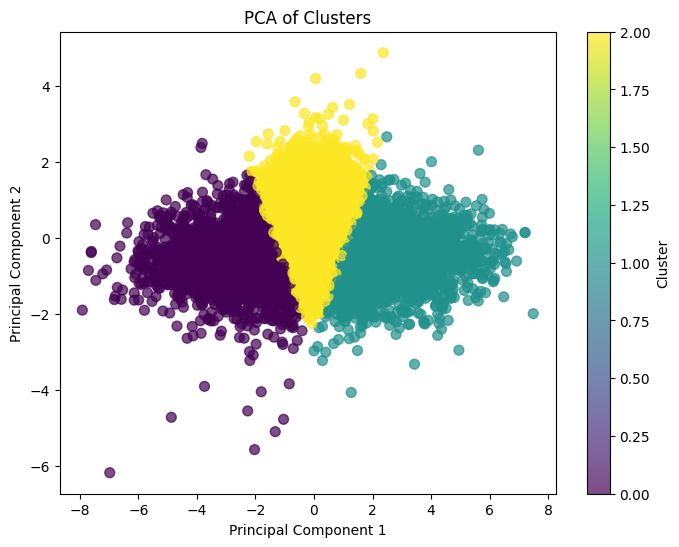

Cluster distribution in percentage:
Cluster 2: 46.50%
Cluster 1: 28.30%
Cluster 0: 25.20%


In [342]:
# Step 1: Drop the target columns and ID for clustering
X = train_data_with_diffs_pca

# Step 2: Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Step 3: Apply PCA to reduce dimensionality to 2 components for visualization
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Step 4: Apply KMeans clustering (you can change the number of clusters as needed)
kmeans = KMeans(n_clusters=3, random_state=42)
y_kmeans = kmeans.fit_predict(X_pca)

# Step 5: Calculate the percentage distribution of clusters
cluster_counts = Counter(y_kmeans)
total_samples = len(y_kmeans)
cluster_percentage = {k: (v / total_samples) * 100 for k, v in cluster_counts.items()}

# Step 6: Plot the PCA results with clusters
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_kmeans, cmap='viridis', s=50, alpha=0.7)
plt.title('PCA of Clusters')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar(label='Cluster')
plt.show()

# Print the percentage distribution of the clusters
print("Cluster distribution in percentage:")
for cluster, percentage in cluster_percentage.items():
    print(f"Cluster {cluster}: {percentage:.2f}%")


In [343]:
# Assuming y_kmeans is the predicted cluster labels and y (the true labels) is derived from HOME_WINS, DRAW, and AWAY_WINS
# Step 1: Create the true labels (y) by using argmax on the target columns
y_true = np.argmax(train_data_with_diffs[target_columns].values, axis=1)

# Step 2: Create a mapping for clusters to the real classes (HOME_WINS, DRAW, AWAY_WINS)
# We know the cluster assignments based on the problem description
cluster_to_real_class = {1: 0,  # Cluster 1 -> HOME_WINS
                         0: 2,  # Cluster 2 -> AWAY_WINS
                         2: 1}  # Cluster 0 -> DRAW

# Step 3: Assign the predicted labels (clusters) to real classes based on the mapping
y_pred = np.array([cluster_to_real_class[cluster] for cluster in y_kmeans])

# Step 4: Calculate precision for each class (0 = HOME_WINS, 1 = DRAW, 2 = AWAY_WINS)
precision = precision_score(y_true, y_pred, average=None)

# Print the precision for each class
class_names = ['HOME_WINS', 'DRAW', 'AWAY_WINS']
for i, class_name in enumerate(class_names):
    print(f"Precision for {class_name}: {precision[i]:.2f}")


Precision for HOME_WINS: 0.62
Precision for DRAW: 0.29
Precision for AWAY_WINS: 0.48


In [344]:
# Step 1: Ensure the test dataset contains the 'ID' column
test_ids = test_data_with_diffs['ID'].values
X_test_final = test_data_with_diffs.drop(columns=['ID'])

# Step 2: Impute missing values (SimpleImputer with mean strategy)
imputer = SimpleImputer(strategy='mean')
X_test_imputed = imputer.fit_transform(X_test_final)

# Step 3: Standardize the test features
scaler = StandardScaler()
X_test_scaled = scaler.fit_transform(X_test_imputed)

# Step 4: Apply PCA to reduce dimensionality (you can change n_components if needed)
pca = PCA(n_components=2)  # Using 2 components for visualization
X_test_pca = pca.fit_transform(X_test_scaled)

# Step 5: Map the PCA components to predicted classes
# Use heuristics to assign predicted classes based on the PCA components
# For example, you can create an arbitrary decision rule based on the first component value
# You may replace this part with a classifier or another method if you have a trained model

predictions = pd.DataFrame(0, index=range(len(X_test_pca)), columns=['HOME_WINS', 'DRAW', 'AWAY_WINS'])

# Example rule: Let's assign based on the first principal component for simplicity
# - Positive values for PC1 -> 'HOME_WINS'
# - Negative values for PC1 -> 'AWAY_WINS'
# - Zero values for PC1 -> 'DRAW'
for i, pca_val in enumerate(X_test_pca[:, 0]):  # Use PC1 for decision
    if pca_val > 0:
        predictions.at[i, 'HOME_WINS'] = 1
    elif pca_val < 0:
        predictions.at[i, 'AWAY_WINS'] = 1
    else:
        predictions.at[i, 'DRAW'] = 1

# Step 6: Add the 'ID' column back to the predictions DataFrame
predictions['ID'] = test_ids

# Step 7: Reorder columns to have 'ID' first
predictions = predictions[['ID', 'HOME_WINS', 'DRAW', 'AWAY_WINS']]

# Step 8: Save the predictions to a CSV file
predictions.to_csv('submission_pca.csv', index=False)

print("Submission file created: submission_pca.csv")

Submission file created: submission_pca.csv


In [345]:
# Step 1: Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(train_data_with_diffs_pca)

# Step 2: Apply Agglomerative Clustering (n_clusters=3 to ensure exactly 3 clusters)
agg_clustering = AgglomerativeClustering(n_clusters=3, linkage='ward')  # No 'affinity' parameter here
y_agg = agg_clustering.fit_predict(X_scaled)

# Step 3: Create true labels (HOME_WINS, DRAW, AWAY_WINS)
y_true = np.argmax(train_data_with_diffs[target_columns].values, axis=1)

# Step 4: Create a mapping for clusters to the real classes
# We'll find the mode of the true labels within each cluster
cluster_to_real_class = {}
for cluster in set(y_agg):
    # Get the mode of the true labels within the cluster
    cluster_mask = y_agg == cluster
    mode_class = np.argmax(np.bincount(y_true[cluster_mask]))
    cluster_to_real_class[cluster] = mode_class

# Step 5: Map predicted clusters to real classes
y_pred_agg = np.array([cluster_to_real_class.get(cluster, -1) for cluster in y_agg])

# Step 6: Calculate precision for each class
precision = precision_score(y_true, y_pred_agg, average=None)

# Print the precision for each class
class_names = ['HOME_WINS', 'DRAW', 'AWAY_WINS']
for i, class_name in enumerate(class_names):
    print(f"Precision for {class_name}: {precision[i]:.2f}")

Precision for HOME_WINS: 0.51
Precision for DRAW: 0.00
Precision for AWAY_WINS: 0.42
